In [1]:
import anndata as ad
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=120, facecolor='white')

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.20.3 scipy==1.7.3 pandas==1.4.1 scikit-learn==1.0.2 statsmodels==0.12.2 python-igraph==0.9.9 pynndescent==0.5.6


In [2]:
AN20 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_transplanted/data/Ambient_RNA_Cleaned/AN20_cleaned.h5ad')
AN21 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_transplanted/data/Ambient_RNA_Cleaned/AN21_cleaned.h5ad')
AN22 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_transplanted/data/Ambient_RNA_Cleaned/AN22_cleaned.h5ad')

AN20.var_names_make_unique()
AN21.var_names_make_unique()
AN22.var_names_make_unique()

AN20.obs.index = AN20.obs.index.map(lambda x: x.split('-')[0]+'-10')
AN21.obs.index = AN21.obs.index.map(lambda x: x.split('-')[0]+'-11')
AN22.obs.index = AN22.obs.index.map(lambda x: x.split('-')[0]+'-12')

Old_transplanted_Ambient_RNA_cleaned_join_inner = ad.concat([AN20, AN21, AN22], label="batch", keys=["AN20", "AN21", "AN22"], join="inner")
Old_transplanted_Ambient_RNA_cleaned_join_inner.obs.loc[Old_transplanted_Ambient_RNA_cleaned_join_inner.obs.batch.isin(['AN20', 'AN21', 'AN22']), 'Type'] = 'Old_transplanted'

In [3]:
adata_Il10RN = Old_transplanted_Ambient_RNA_cleaned_join_inner[(Old_transplanted_Ambient_RNA_cleaned_join_inner.to_df()['Il10ra'] == 0), :]
adata_Il10 = adata_Il10RN[(adata_Il10RN.to_df()['Il10'] > 0), :]
adata_Il10N = Old_transplanted_Ambient_RNA_cleaned_join_inner[(Old_transplanted_Ambient_RNA_cleaned_join_inner.to_df()['Il10'] == 0), :]
adata_Il10ra = adata_Il10N[(adata_Il10N.to_df()['Il10ra'] > 0), :]
adata_DN = adata_Il10N[(adata_Il10N.to_df()['Il10ra'] == 0), :]
Old_transplanted_Ambient_RNA_cleaned_join_inner = ad.concat([adata_Il10, adata_Il10ra, adata_DN], label="IL10", keys=["IL10_Old_transplanted", "IL10ra_Old_transplanted", "DN_Old_transplanted"])

In [4]:
Old_transplanted_Ambient_RNA_cleaned_join_inner

AnnData object with n_obs × n_vars = 14251 × 32285
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'Type', 'IL10'

normalizing counts per cell
    finished (0:00:00)


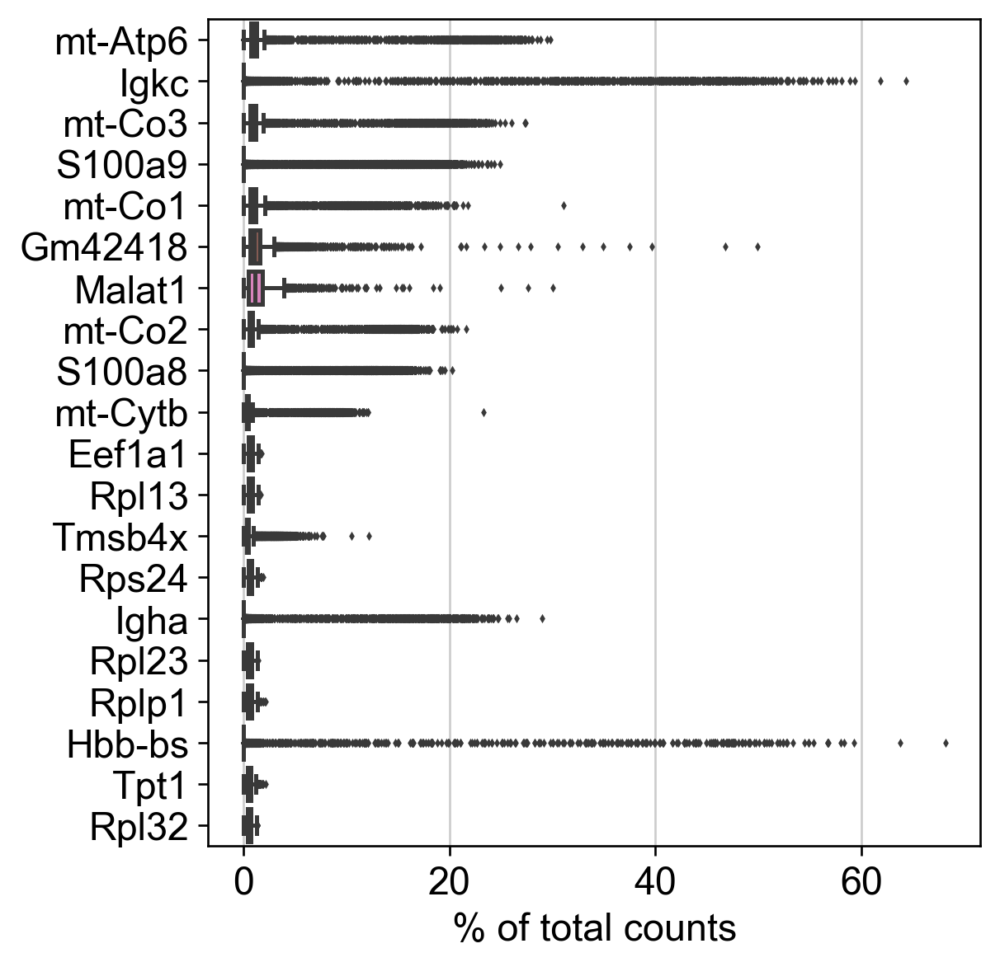

In [5]:
sc.pl.highest_expr_genes(Old_transplanted_Ambient_RNA_cleaned_join_inner, n_top=20)

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Type' as categorical


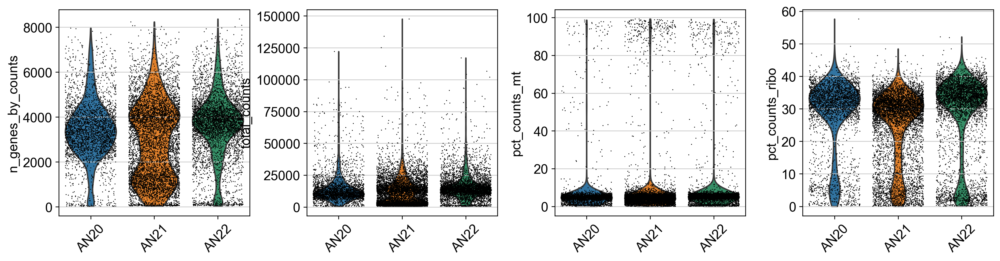

In [6]:
# mitochondrial genes
Old_transplanted_Ambient_RNA_cleaned_join_inner.var['mt'] = Old_transplanted_Ambient_RNA_cleaned_join_inner.var_names.str.startswith('mt-') 
# ribosomal genes
Old_transplanted_Ambient_RNA_cleaned_join_inner.var['ribo'] = Old_transplanted_Ambient_RNA_cleaned_join_inner.var_names.str.startswith(("Rps","Rpl"))

sc.pp.calculate_qc_metrics(Old_transplanted_Ambient_RNA_cleaned_join_inner, qc_vars=['mt','ribo'], percent_top=None, log1p=False, inplace=True)

# A violin plot of some of the computed quality measures:
#     the number of genes expressed in the count matrix
#     the total counts per cell
#     the percentage of counts in mitochondrial genes
#     the percentage of counts in ribosomal genes
sc.pl.violin(Old_transplanted_Ambient_RNA_cleaned_join_inner, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo'], jitter=0.4, groupby = 'batch', rotation= 45)

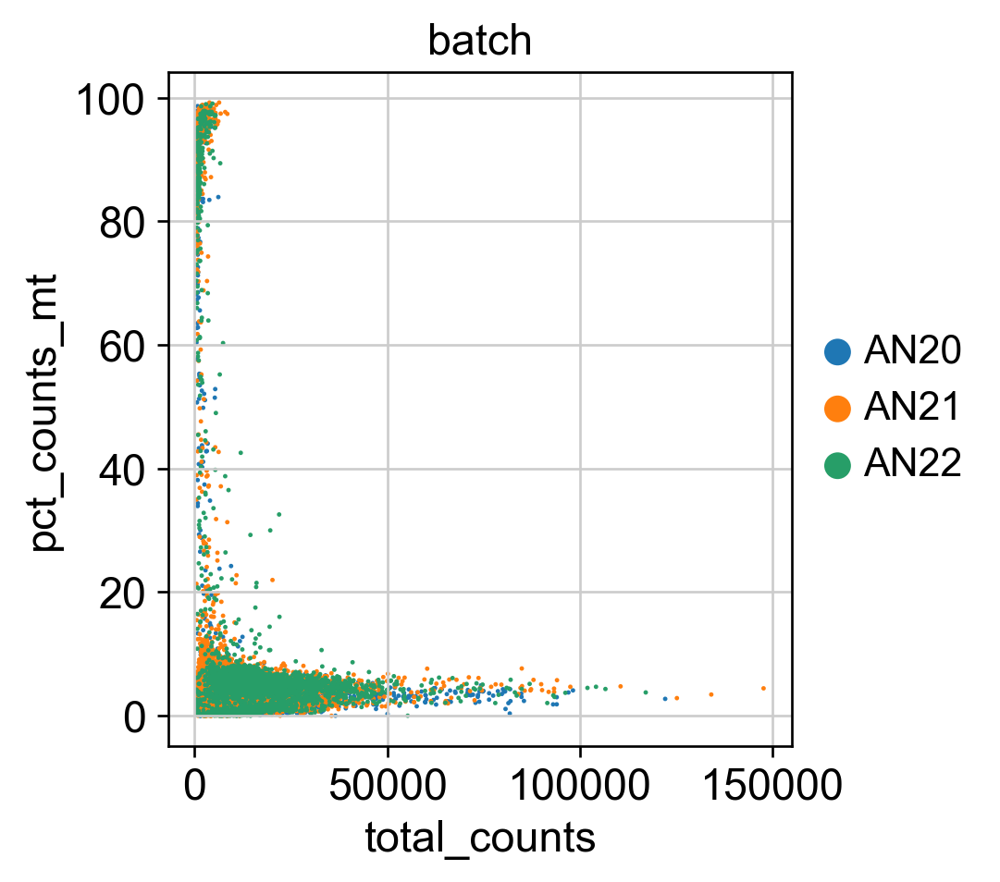

In [7]:
sc.pl.scatter(Old_transplanted_Ambient_RNA_cleaned_join_inner, x='total_counts', y='pct_counts_mt', color='batch')

In [8]:
#Basic filtering:
sc.pp.filter_cells(Old_transplanted_Ambient_RNA_cleaned_join_inner, min_genes=200)
sc.pp.filter_genes(Old_transplanted_Ambient_RNA_cleaned_join_inner, min_cells=3)

filtered out 502 cells that have less than 200 genes expressed
filtered out 12483 genes that are detected in less than 3 cells


In [9]:
Old_transplanted_Ambient_RNA_cleaned_join_inner.shape

(13749, 19802)

In [10]:
# Remove cells that have too many mitochondrial genes expressed or too little ribosomal genes expressed:
Old_transplanted_Ambient_RNA_cleaned_join_inner = Old_transplanted_Ambient_RNA_cleaned_join_inner[Old_transplanted_Ambient_RNA_cleaned_join_inner.obs.pct_counts_mt < 10, :]
Old_transplanted_Ambient_RNA_cleaned_join_inner = Old_transplanted_Ambient_RNA_cleaned_join_inner[Old_transplanted_Ambient_RNA_cleaned_join_inner.obs.pct_counts_ribo > 5, :]

In [11]:
Old_transplanted_Ambient_RNA_cleaned_join_inner.shape

(12464, 19802)

Trying to set attribute `.var` of view, copying.


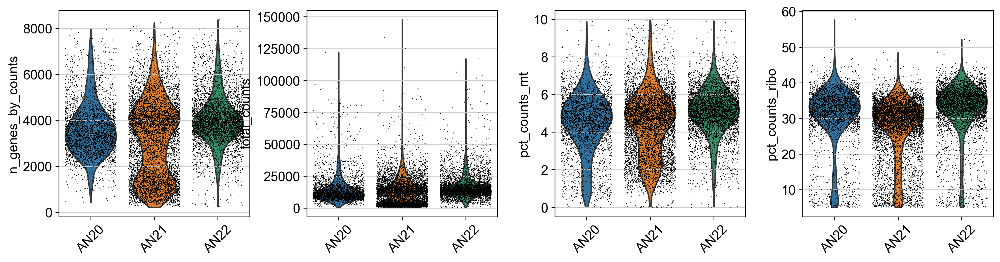

In [12]:
# mitochondrial genes
Old_transplanted_Ambient_RNA_cleaned_join_inner.var['mt'] = Old_transplanted_Ambient_RNA_cleaned_join_inner.var_names.str.startswith('mt-') 
# ribosomal genes
Old_transplanted_Ambient_RNA_cleaned_join_inner.var['ribo'] = Old_transplanted_Ambient_RNA_cleaned_join_inner.var_names.str.startswith(("Rps","Rpl"))

sc.pp.calculate_qc_metrics(Old_transplanted_Ambient_RNA_cleaned_join_inner, qc_vars=['mt','ribo'], percent_top=None, log1p=False, inplace=True)

sc.pl.violin(Old_transplanted_Ambient_RNA_cleaned_join_inner, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo'], jitter=0.4, groupby = 'batch', rotation= 45)

In [13]:
np.median(Old_transplanted_Ambient_RNA_cleaned_join_inner.obs.n_genes_by_counts)

3664.0

In [14]:
from statsmodels import robust
robust.mad(Old_transplanted_Ambient_RNA_cleaned_join_inner.obs.n_genes_by_counts)

1232.783744687408

In [15]:
# Old_transplanted_Ambient_RNA_cleaned_join_inner = Old_transplanted_Ambient_RNA_cleaned_join_inner[Old_transplanted_Ambient_RNA_cleaned_join_inner.obs.n_genes_by_counts > 1000, :]

In [16]:
# As the level of expression of mitochondrial genes and Malat1 are judged as mainly technical, it can be wise to remove them from the dataset bofore any further analysis.
malat1 = Old_transplanted_Ambient_RNA_cleaned_join_inner.var_names.str.startswith('Malat1')
Gm42418 = Old_transplanted_Ambient_RNA_cleaned_join_inner.var_names.str.startswith('Gm42418')
mito_genes = Old_transplanted_Ambient_RNA_cleaned_join_inner.var_names.str.startswith('mt-')

remove = np.add(mito_genes, malat1)
remove = np.add(remove, Gm42418)

keep = np.invert(remove)

Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt = Old_transplanted_Ambient_RNA_cleaned_join_inner[:,keep]

In [17]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.shape

(12464, 19787)

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


Trying to set attribute `.obs` of view, copying.


Automatically set threshold at doublet score = 0.80
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.5%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 4.7%
Elapsed time: 15.5 seconds


(<Figure size 960x360 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

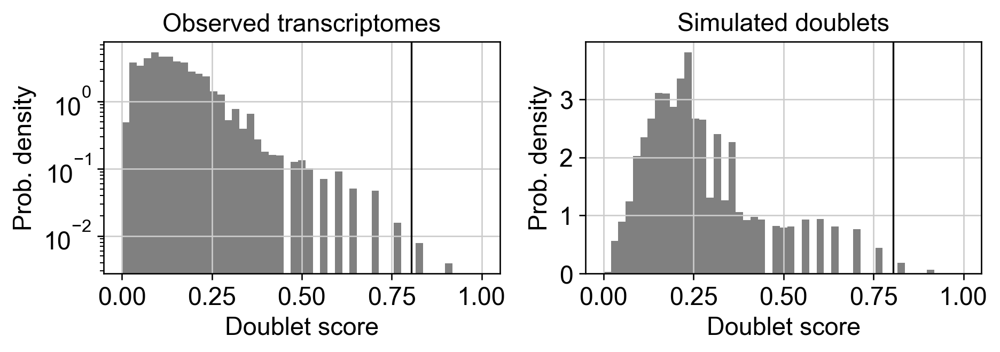

In [18]:
# Predict doublets
scrub = scr.Scrublet(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.X)
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.obs['doublet_scores'], Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.obs['predicted_doublets'] = scrub.scrub_doublets()
scrub.plot_histogram()

In [19]:
sum(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.obs['predicted_doublets'])

3

In [20]:
# add in column with singlet/doublet instead of True/False
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.obs['doublet_info'] = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.obs["predicted_doublets"].astype(str)
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt[Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.obs['doublet_info'] == 'False',:]

In [21]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.shape

(12461, 19787)

In [22]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.obs.pop('doublet_info')
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.obs.pop('doublet_scores')
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.obs.pop('predicted_doublets')

AACAAAGTCGCCGAAC-10    False
AGAAGTAGTCCATCTC-10    False
AGCGCCATCTCGGGAC-10    False
AGTACTGCAGTTCTAG-10    False
ATACTTCCAGGCACTC-10    False
                       ...  
TTTGGTTGTGGAACCA-12    False
TTTGGTTTCGATGCAT-12    False
TTTGGTTTCGGAGTGA-12    False
TTTGTTGAGGTTGTTC-12    False
TTTGTTGTCACTCGAA-12    False
Name: predicted_doublets, Length: 12461, dtype: bool

In [23]:
# Save the result.
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.write('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_nonlognorm_join_inner_200_3_10_5_scrublet_no_mt_raw.h5ad')

In [108]:
import anndata as ad
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=120, facecolor='white')

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.20.3 scipy==1.7.3 pandas==1.4.1 scikit-learn==1.0.2 statsmodels==0.12.2 python-igraph==0.9.9 pynndescent==0.5.6


In [16]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_nonlognorm_join_inner_200_3_10_5_scrublet_no_mt_raw.h5ad')

In [17]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt[:, ((Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.X > 2).sum(axis=0) / Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.shape[0] ) > 0.05]

In [18]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent

View of AnnData object with n_obs × n_vars = 12461 × 3362
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'Type', 'IL10', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_genes'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'batch_colors'

In [19]:
# Total-count normalize (library-size correct) the data matrix X to 10,000 reads per cell, so that counts become comparable among cells.
sc.pp.normalize_total(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt, target_sum=1e4)

# Logarithmize the data:
sc.pp.log1p(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt)

normalizing counts per cell
    finished (0:00:00)


extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


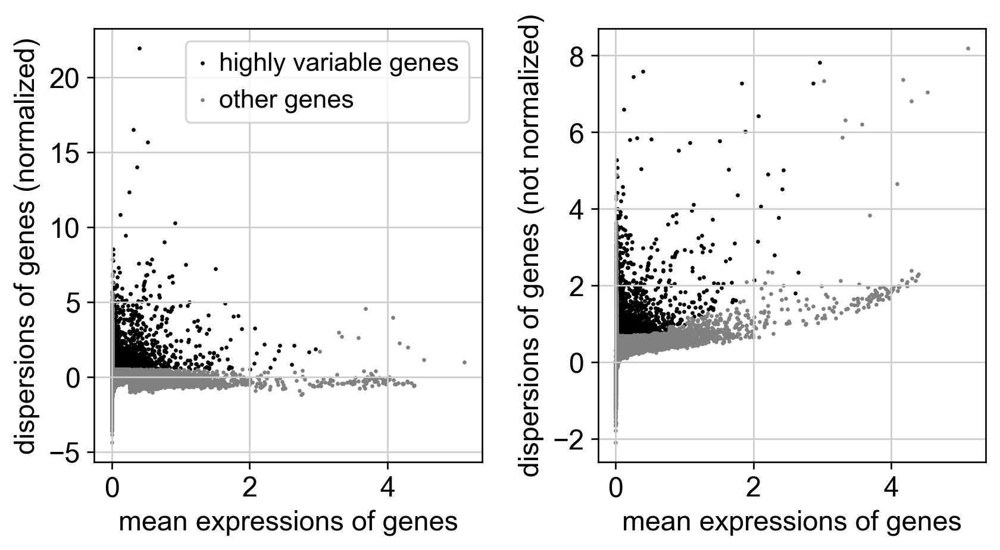

In [20]:
# Identify highly-variable genes.
sc.pp.highly_variable_genes(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt, min_mean=0.0125, max_mean=3, min_disp=0.5)

sc.pl.highly_variable_genes(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt)

In [21]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt

AnnData object with n_obs × n_vars = 12461 × 19787
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'Type', 'IL10', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_genes'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'log1p', 'hvg'

In [22]:
# Set the .raw attribute of the AnnData object to the normalized and logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. This simply freezes the state of the AnnData object.
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt.raw = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt

# The result of the previous highly-variable-genes detection is stored as an annotation in .var.highly_variable and auto-detected by PCA and hence, sc.pp.neighbors and subsequent manifold/graph tools. In that case, the step actually do the filtering below is unnecessary, too.

# Actually do the filtering
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt[:, Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent.var.index]

#Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_hvgo_regress = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent[:, Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent.var.highly_variable]
#Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:33)


In [23]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress

AnnData object with n_obs × n_vars = 12461 × 3362
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'Type', 'IL10', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_genes'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'log1p', 'hvg'

In [24]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress
# BATCH CORRECTION USING ComBat
# run combat
sc.pp.combat(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, key='batch')

Standardizing Data across genes.

Found 3 batches

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data



In [25]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat

AnnData object with n_obs × n_vars = 12461 × 3362
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'Type', 'IL10', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_genes'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'log1p', 'hvg'

In [26]:
# Save the result.
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat.write('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_lognorm_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_regress_combat_raw_SingleR.h5ad')

In [27]:
# PCA, TSNE, UMAP and Clustering

In [109]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_lognorm_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_regress_combat_raw_SingleR.h5ad')
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat.raw = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat

df = pd.read_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_cell_types_lognorm_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_regress_combat_raw_SingleR.csv", index_col=0)
labels = df['labels']
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat.obs['cell_type'] = labels
pd.crosstab(index=Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat.obs.batch, columns=Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat.obs.cell_type)

cell_type,CLP,CMP,Flk2n,Flk2p,GMP,HSC,MEP
batch,,,,,,,
AN20,76,27,84,3,347,2064,152
AN21,324,430,212,33,754,3603,254
AN22,177,54,103,7,258,3407,92


In [110]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, max_value=10)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical


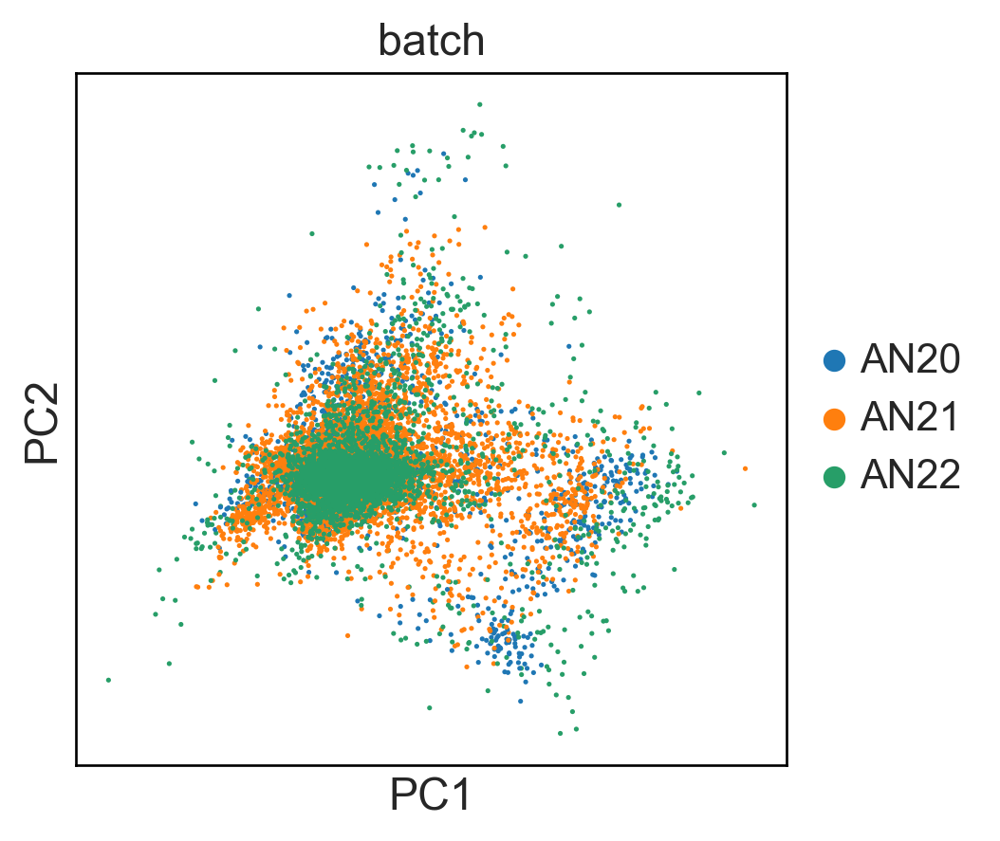

In [111]:
# Principal component analysis

# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, svd_solver='arpack')

# We can make a scatter plot in the PCA coordinates, but we will not use that later on.
sc.pl.pca(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, color='batch')

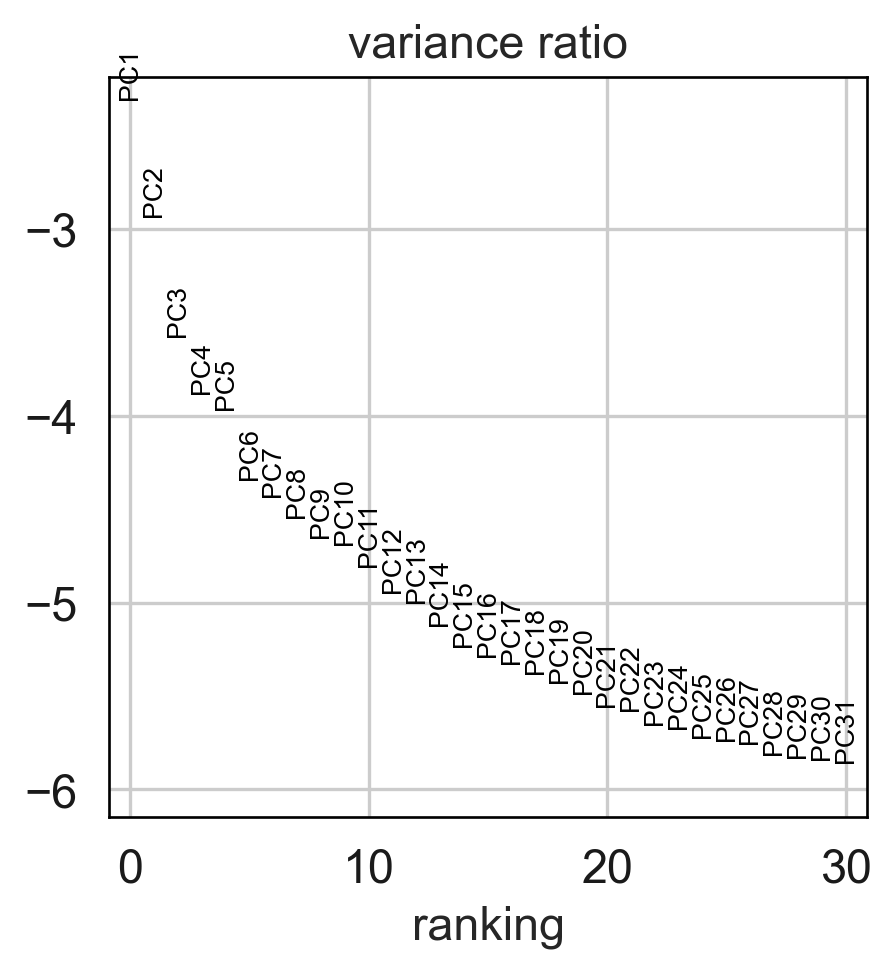

In [112]:
# Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function sc.tl.louvain() or tSNE sc.tl.tsne(). In our experience, often a rough estimate of the number of PCs does fine.
sc.pl.pca_variance_ratio(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, log=True)

In [113]:
# Computing the neighborhood graph

#Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat’s results, let’s take the following values.
sc.pp.neighbors(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, n_neighbors=15, n_pcs=45)

computing neighbors
    using 'X_pca' with n_pcs = 45
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:21)


computing tSNE
    using 'X_pca' with n_pcs = 30
    using sklearn.manifold.TSNE


/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:25)


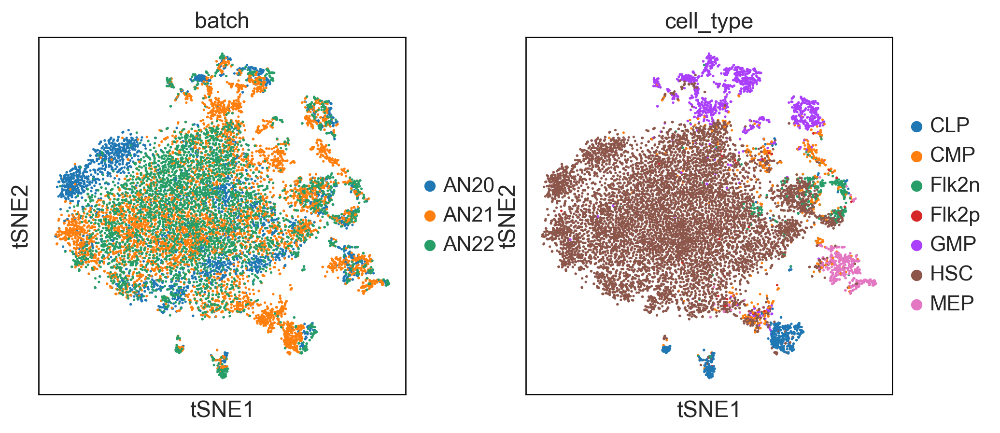

In [114]:
sc.tl.tsne(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, n_pcs = 30)

sc.pl.tsne(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, color=['batch', 'cell_type'])

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


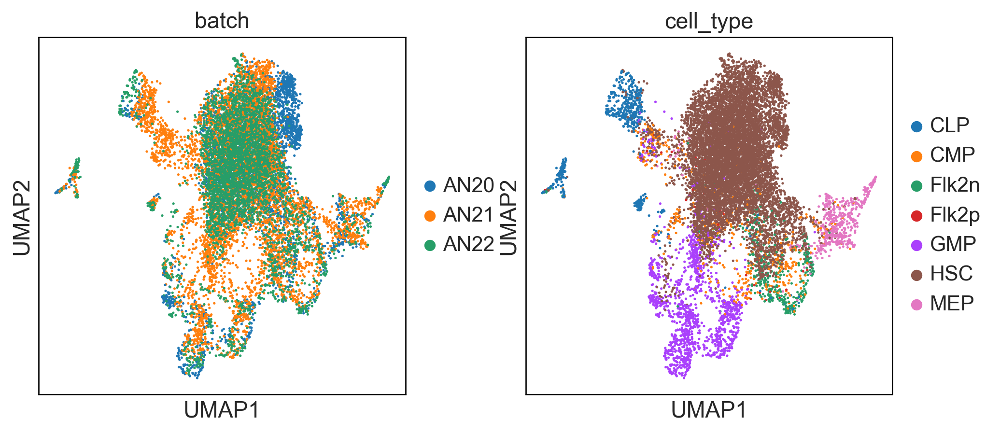

In [115]:
# Embedding the neighborhood graph

# We suggest embedding the graph in two dimensions using UMAP (McInnes et al., 2018), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

# tl.paga(adata)
# pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
# tl.umap(adata, init_pos='paga')

sc.tl.umap(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat)

sc.pl.umap(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, color=['batch', 'cell_type'])

running Leiden clustering
    finished: found 6 clusters and added
    'leiden_0.2', the cluster labels (adata.obs, categorical) (0:00:00)


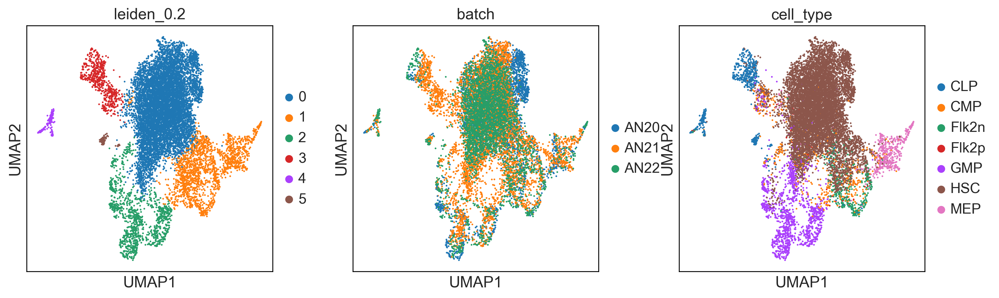

In [116]:
# Clustering the neighborhood graph

# As with Seurat and many other frameworks, we recommend the Leiden graph-clustering method (community detection based on optimizing modularity) by Traag *et al.* (2018). Note that Leiden clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.
sc.tl.leiden(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, resolution = 0.2, key_added = "leiden_0.2")

# Plot the clusters:
sc.pl.umap(Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat, color=['leiden_0.2', 'batch', 'cell_type'])

In [232]:
#Save the clusters.
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat.obs.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_clusters_join_inner_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat_raw_SingleR.csv")

In [233]:
# Save the result.
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat.write('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_join_inner_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat_raw_SingleR.h5ad')

In [1]:
# DGE

import numpy as np
import pandas as pd
import scanpy as sc

In [2]:
Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_join_inner_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat_raw_SingleR.h5ad')

Old_transplanted_Ambient_RNA_cleaned_HSC = Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat[Old_transplanted_Ambient_RNA_cleaned_join_inner_no_mt_2_UMI_5_percent_regress_combat.obs.cell_type == 'HSC']

Old_transplanted_Ambient_RNA_cleaned_HSC.obs

,orig.ident,nCount_RNA,nFeature_RNA,batch,Type,IL10,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,n_genes,cell_type,leiden_0.2
ATACTTCCAGGCACTC-10,0,16057.701190,4620,AN20,Old_transplanted,IL10_Old_transplanted,4620,16057.701172,390.508392,2.431907,4886.104980,30.428421,4620,HSC,0
CAAAGAACATGACTCA-10,0,12919.310257,3579,AN20,Old_transplanted,IL10_Old_transplanted,3579,12919.310547,671.111145,5.194636,4936.107422,38.207207,3579,HSC,0
CCTCAACGTCTCAAGT-10,0,11588.909153,3467,AN20,Old_transplanted,IL10_Old_transplanted,3467,11588.909180,638.703918,5.511337,4280.323730,36.934654,3467,HSC,0
GACTGATAGTAGGTTA-10,0,7558.375238,2772,AN20,Old_transplanted,IL10_Old_transplanted,2772,7558.375000,401.542603,5.312552,2505.005615,33.142120,2772,HSC,0
GCCTGTTGTCGATTAC-10,0,13904.683979,4463,AN20,Old_transplanted,IL10_Old_transplanted,4462,13903.684570,832.608765,5.988404,3402.683594,24.473251,4463,HSC,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTAGATGGTCG-12,0,15610.136877,4153,AN22,Old_transplanted,DN_Old_transplanted,4153,15610.136719,973.094849,6.233737,5658.976074,36.251934,4153,HSC,0
TTTGGTTAGCATATGA-12,0,18787.831523,4878,AN22,Old_transplanted,DN_Old_transplanted,4878,18787.832031,961.273865,5.116470,6175.106934,32.867588,4878,HSC,0
TTTGGTTTCGATGCAT-12,0,11900.146842,3421,AN22,Old_transplanted,DN_Old_transplanted,3420,11899.146484,577.182129,4.850618,4608.429688,38.729076,3421,HSC,0
TTTGTTGAGGTTGTTC-12,0,9013.997249,2933,AN22,Old_transplanted,DN_Old_transplanted,2933,9013.998047,465.857269,5.168154,3273.643311,36.317329,2933,HSC,0


In [3]:
pd.crosstab(index=Old_transplanted_Ambient_RNA_cleaned_HSC.obs.batch, columns=Old_transplanted_Ambient_RNA_cleaned_HSC.obs.IL10)

IL10,IL10_Old_transplanted,IL10ra_Old_transplanted,DN_Old_transplanted
batch,,,
AN20,7,305,1752
AN21,8,366,3229
AN22,13,171,3223


In [4]:
expression_matrix = pd.DataFrame(Old_transplanted_Ambient_RNA_cleaned_HSC.X)
expression_matrix.columns = Old_transplanted_Ambient_RNA_cleaned_HSC.var.index
expression_matrix = expression_matrix.T
gene_list = list(Old_transplanted_Ambient_RNA_cleaned_HSC.var.index)
column_values = pd.Series(gene_list)
expression_matrix.insert(loc=0, column='Description', value=column_values)
expression_matrix.insert(loc=0, column='NAME', value=gene_list)
expression_matrix['NAME'] = expression_matrix['NAME'].str.upper()
expression_matrix.index = range(len(expression_matrix.index))

expression_matrix.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_HSC_expression_matrix_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.txt', index=None, sep='\t', mode='a')

In [5]:
phenotype_list = list(Old_transplanted_Ambient_RNA_cleaned_HSC.obs.IL10)
first_row = [Old_transplanted_Ambient_RNA_cleaned_HSC.shape[0], '3', '1']
second_row = ['#', 'IL10_Old_transplanted', 'IL10ra_Old_transplanted', 'DN_Old_transplanted']

import csv

with open('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_HSC_phenotype_list_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.cls', 'w') as f:
      
    # using csv.writer method from CSV package
    write = csv.writer(f, delimiter=' ')
      
    write.writerow(first_row)
    write.writerow(second_row)
    write.writerow(phenotype_list)

In [6]:
import gseapy as gp
gene_set_names = gp.get_library_name(organism='Mouse')

In [7]:
groups = ['IL10ra_Old_transplanted', 'DN_Old_transplanted']
IL10ra_vs_DN_GSEA = Old_transplanted_Ambient_RNA_cleaned_HSC[Old_transplanted_Ambient_RNA_cleaned_HSC.obs.IL10.isin(groups)]

In [8]:
expression_matrix_IL10ra_vs_DN = pd.DataFrame(IL10ra_vs_DN_GSEA.X)
expression_matrix_IL10ra_vs_DN.columns = IL10ra_vs_DN_GSEA.var.index
expression_matrix_IL10ra_vs_DN = expression_matrix_IL10ra_vs_DN.T
gene_list = list(IL10ra_vs_DN_GSEA.var.index)
column_values = pd.Series(gene_list)
expression_matrix_IL10ra_vs_DN.insert(loc=0, column='Description', value=column_values)
expression_matrix_IL10ra_vs_DN.insert(loc=0, column='NAME', value=gene_list)
expression_matrix_IL10ra_vs_DN['NAME'] = expression_matrix_IL10ra_vs_DN['NAME'].str.upper()
expression_matrix_IL10ra_vs_DN.index = range(len(expression_matrix_IL10ra_vs_DN.index))

In [9]:
phenotype_list_IL10ra_vs_DN = list(IL10ra_vs_DN_GSEA.obs.IL10)

In [10]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Biological_Process_2021', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png',)

#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_GSEA_GO_BP_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv', index=None)

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:52:46,072 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,DNA-dependent DNA replication (GO:0006261),-0.573756,-2.142193,0.000000,0.000000,129,67,UBC;UBB;PURA;POLD4;PSMD4;PSMB1;SRPK2;PSMC2;PSM...,TOPBP1;PSMD12;PSMD2;SSBP1;MCMBP;PSMC4;RFC1;PSM...
1,NADH dehydrogenase complex assembly (GO:0010257),-0.653613,-2.248270,0.000000,0.000000,58,39,NDUFA6;NDUFS3;NDUFB11;NDUFA11;OXA1L;NDUFS7;NDU...,NDUFS5;NDUFA5;NDUFA3;NDUFB10;NDUFA1;NDUFB3;NDU...
2,aerobic electron transport chain (GO:0019646),-0.637341,-2.395743,0.000000,0.000000,70,60,COX7A2L;SDHA;NDUFA6;SDHC;UQCC3;NDUFS3;UQCRC2;N...,NDUFS5;COX4I1;NDUFA5;NDUFA3;NDUFB10;NDUFA1;SDH...
3,mitochondrial ATP synthesis coupled electron t...,-0.637341,-2.395743,0.000000,0.000000,71,60,COX7A2L;SDHA;NDUFA6;SDHC;UQCC3;NDUFS3;UQCRC2;N...,NDUFS5;COX4I1;NDUFA5;NDUFA3;NDUFB10;NDUFA1;SDH...
4,"mitochondrial electron transport, NADH to ubiq...",-0.669322,-2.318812,0.000000,0.000000,39,36,NDUFA6;NDUFS3;NDUFB11;NDUFA11;NDUFS7;NDUFV1;ND...,NDUFS5;NDUFA5;NDUFA3;NDUFB10;NDUFA1;NDUFB3;NDU...
...,...,...,...,...,...,...,...,...,...
257,mitotic sister chromatid segregation (GO:0000070),-0.382079,-1.406774,0.045455,0.215551,102,34,CHMP4B;NIPBL;SMC4;RAD21;RAB11A;PDCD6IP;CHMP5;V...,SET;CDCA8;CDK1;KMT5A;CENPE;RAN
258,regulation of mitotic cell cycle phase transit...,-0.336539,-1.367127,0.039216,0.231647,188,89,ID2;PPP1R9B;UBC;ZFP36L1;ZFP36L2;PTPN6;UBB;CSNK...,CETN2;PSMC6;PSME3;UBE2C;PSMB7;PSMD6;UBE2E1;PSM...
259,positive regulation of gene expression (GO:001...,0.318173,1.343917,0.000000,0.234056,482,131,CLDN5;PTGER4;PLSCR1;ID2;CITED2;STAT3;CIRBP;MSN...,CLDN5;PTGER4;PLSCR1;ID2;CITED2;STAT3;CIRBP;MSN...
260,protein localization to membrane (GO:0072657),0.373204,1.328206,0.038462,0.242910,195,41,TNFRSF1A;FLOT1;RAB38;FCHO2;SPTBN1;ROCK2;SH3GLB...,TNFRSF1A;FLOT1;RAB38;FCHO2;SPTBN1;ROCK2;SH3GLB...


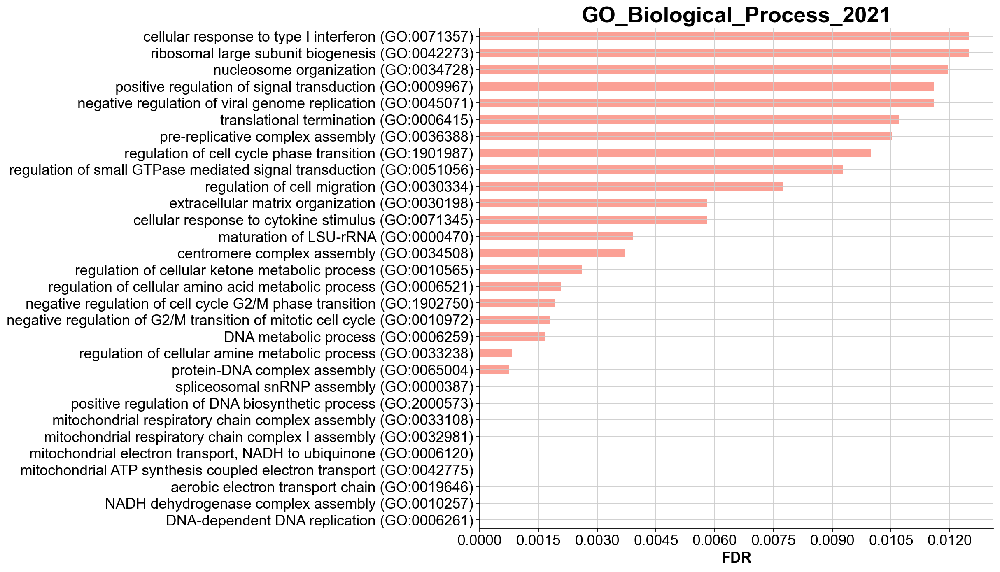

In [11]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN GSEA GO BP.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10))

In [12]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Molecular_Function_2021', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_GSEA_GO_MF_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:53:19,992 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,NADH dehydrogenase (quinone) activity (GO:0050...,-0.670592,-2.197489,0.000000,0.000000,35,33,NDUFA6;NDUFS3;NDUFS7;NDUFV1;NDUFB9;NDUFA8;NDUF...,NDUFS5;NDUFA5;NDUFA3;NDUFB10;NDUFA1;NDUFB3;NDU...
1,NADH dehydrogenase (ubiquinone) activity (GO:0...,-0.670592,-2.197489,0.000000,0.000000,35,33,NDUFA6;NDUFS3;NDUFS7;NDUFV1;NDUFB9;NDUFA8;NDUF...,NDUFS5;NDUFA5;NDUFA3;NDUFB10;NDUFA1;NDUFB3;NDU...
2,oxidoreduction-driven active transmembrane tra...,-0.642806,-2.233931,0.000000,0.000000,58,47,COX7A2L;NDUFA6;CYB5A;NDUFS3;NDUFS7;NDUFV1;NDUF...,NDUFS5;COX4I1;NDUFA5;NDUFA3;NDUFB10;NDUFA1;NDU...
3,cis-regulatory region sequence-specific DNA bi...,0.510996,2.148011,0.000000,0.004574,1149,123,XBP1;CEBPD;KLF9;NKX2-3;CEBPB;KLF6;JUNB;STAT3;J...,XBP1;CEBPD;KLF9;NKX2-3;CEBPB;KLF6;JUNB;STAT3;J...
4,RNA polymerase II transcription regulatory reg...,0.518138,2.165181,0.000000,0.006861,1359,139,XBP1;CEBPD;KLF9;NKX2-3;CEBPB;KLF6;JUNB;STAT3;J...,XBP1;CEBPD;KLF9;NKX2-3;CEBPB;KLF6;JUNB;STAT3;J...
5,RNA polymerase II cis-regulatory region sequen...,0.528960,2.168607,0.000000,0.013723,1149,122,XBP1;CEBPD;KLF9;NKX2-3;CEBPB;KLF6;JUNB;STAT3;J...,XBP1;CEBPD;KLF9;NKX2-3;CEBPB;KLF6;JUNB;STAT3;J...
6,protein serine/threonine kinase activity (GO:0...,0.498718,2.023982,0.000000,0.013723,344,79,PIM1;MAP4K4;STK17B;PTK2B;RPS6KA3;CAMK2D;CLK1;C...,PIM1;MAP4K4;STK17B;PTK2B;RPS6KA3;CAMK2D;CLK1;C...
7,calcium ion binding (GO:0005509),0.536077,2.041253,0.000000,0.017153,348,55,SELP;S100A4;PLSCR1;TGM2;S100A6;ITSN1;ANXA7;TPT...,SELP;S100A4;PLSCR1;TGM2;S100A6;ITSN1;ANXA7;TPT...
8,double-stranded DNA binding (GO:0003690),0.441085,1.898649,0.000000,0.038881,651,92,XBP1;CEBPD;NKX2-3;CEBPB;KLF6;JUNB;JUND;KLF2;RB...,XBP1;CEBPD;NKX2-3;CEBPB;KLF6;JUNB;JUND;KLF2;RB...
9,cysteine-type endopeptidase activity (GO:0004197),0.568918,1.815046,0.000000,0.044599,105,23,CTSB;CTSO;CTSL;CTSC;USP7;CFLAR;USP34;USP9X;CAS...,CTSB;CTSO;CTSL;CTSC;USP7;CFLAR;USP34;USP9X;CAS...


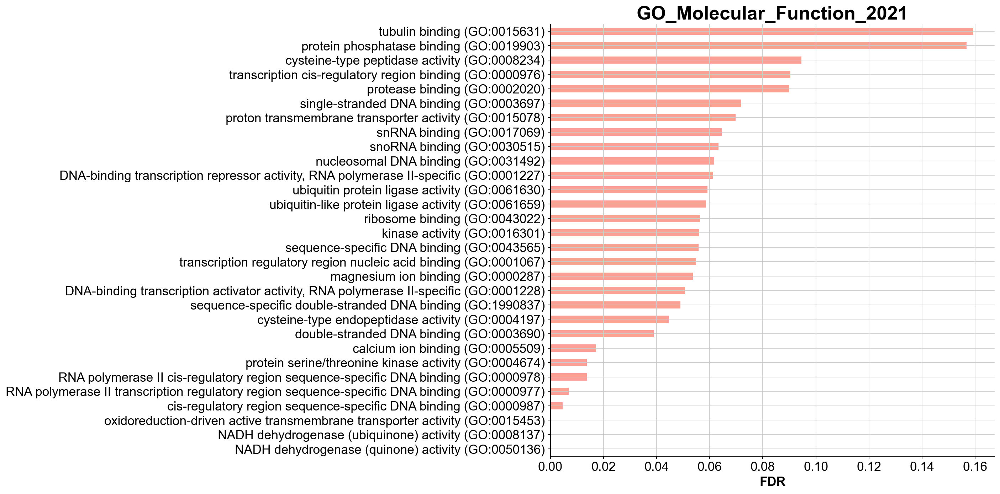

In [13]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN GSEA GO MF.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10))

In [14]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Cellular_Component_2021', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_GSEA_GO_CC_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:53:52,005 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,U12-type spliceosomal complex (GO:0005689),-0.664420,-2.017126,0.000000,0.000000,28,20,ZCRB1;ZRSR2;SF3B3;SF3B2;SF3B4;DHX15;SNRNP48;SF...,SF3B6;SNRPG;LSM7;SNRPD2;YBX1;SNRPF;SNRPD1;SNRPD3
1,collagen-containing extracellular matrix (GO:0...,0.587104,2.122324,0.000000,0.000000,380,41,PRTN3;S100A4;PLSCR1;TGM2;CTSB;S100A6;CTSL;CTSC...,PRTN3;S100A4;PLSCR1;TGM2;CTSB;S100A6;CTSL;CTSC...
2,integral component of plasma membrane (GO:0005...,0.572488,2.497469,0.000000,0.000000,1454,104,CD53;ALCAM;SELP;ADGRL4;PLSCR1;PROCR;CLEC1A;IL2...,CD53;ALCAM;SELP;ADGRL4;PLSCR1;PROCR;CLEC1A;IL2...
3,lysosome (GO:0005764),0.543912,2.241556,0.000000,0.000000,477,97,IFITM1;IFITM3;IFITM2;CTSB;CTSO;LAMP2;FLOT1;CTS...,IFITM1;IFITM3;IFITM2;CTSB;CTSO;LAMP2;FLOT1;CTS...
4,lytic vacuole membrane (GO:0098852),0.538096,2.110973,0.000000,0.000000,267,60,IFITM1;IFITM3;IFITM2;LAMP2;FLOT1;CD63;RAB5C;SL...,IFITM1;IFITM3;IFITM2;LAMP2;FLOT1;CD63;RAB5C;SL...
...,...,...,...,...,...,...,...,...,...
60,nucleolus (GO:0005730),-0.316764,-1.502092,0.000000,0.092831,733,269,PIM1;VMP1;PLSCR1;KLF6;RPS6KA3;MYCN;IMP3;CAPG;N...,PPID;ACSL5;NOP14;PDCD11;EIF6;GTPBP4;SMC2;TAF15...
61,endoplasmic reticulum lumen (GO:0005788),0.370749,1.467692,0.023256,0.096113,285,47,PNPLA2;CTSC;SHISA5;QSOX1;SELENOM;LGALS1;APOE;E...,PNPLA2;CTSC;SHISA5;QSOX1;SELENOM;LGALS1;APOE;E...
62,cytoskeleton (GO:0005856),0.329990,1.473690,0.019608,0.096725,600,132,ARHGAP6;TMOD3;PPP1R9B;AKAP13;MSN;PLEC;SDCBP;BA...,ARHGAP6;TMOD3;PPP1R9B;AKAP13;MSN;PLEC;SDCBP;BA...
63,nuclear lumen (GO:0031981),-0.307450,-1.470604,0.000000,0.103706,745,271,PIM1;VMP1;PLSCR1;KLF6;RPS6KA3;MYCN;JUN;IMP3;CA...,PPID;ACSL5;NOP14;PDCD11;EIF6;GTPBP4;SMC2;TAF15...


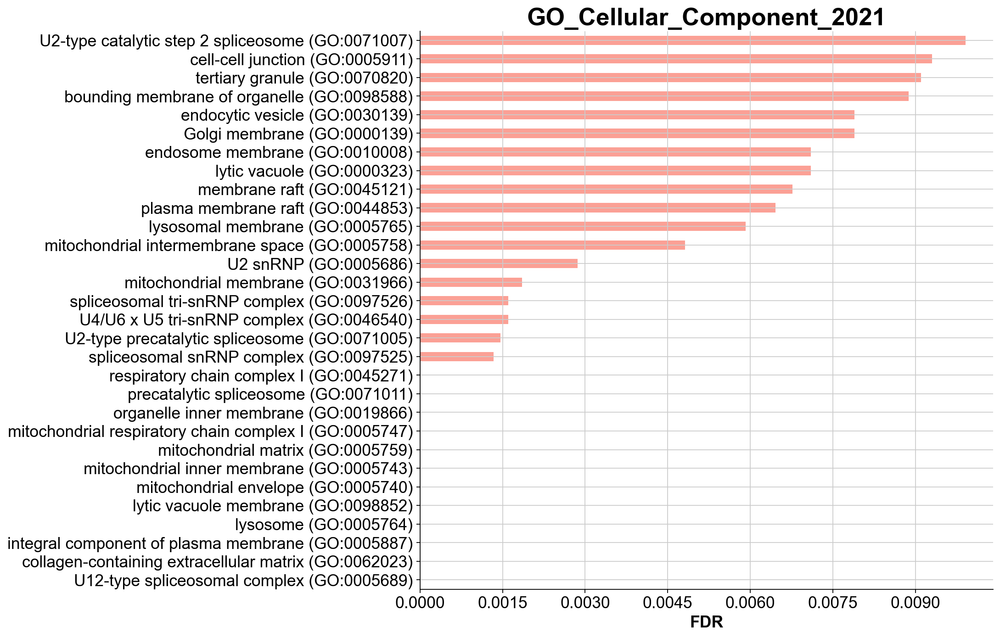

In [15]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN GSEA GO CC.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10))

In [16]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='KEGG_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_GSEA_KEGG_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:54:13,020 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,HIF-1 signaling pathway,0.594960,2.260605,0.000000,0.000000,104,38,STAT3;HK2;CAMK2D;IFNGR1;PIK3R1;PLCG2;IGF1R;PIK...,STAT3;HK2;CAMK2D;IFNGR1;PIK3R1;PLCG2;IGF1R;PIK...
1,Huntington disease,-0.530885,-2.222429,0.000000,0.000000,192,115,TGM2;CREBBP;COX7A2L;CLTB;EP300;REST;CLTC;SP1;A...,POLR2G;CASP3;VDAC2;SOD2;NDUFS5;COX4I1;POLR2I;N...
2,Leukocyte transendothelial migration,0.543954,2.092181,0.000000,0.000000,115,40,CLDN5;PTK2B;MSN;PIK3R1;PLCG2;PIK3CD;RAC1;NCF2;...,CLDN5;PTK2B;MSN;PIK3R1;PLCG2;PIK3CD;RAC1;NCF2;...
3,Lysosome,0.620328,2.151998,0.000000,0.000000,124,34,CTSB;CTSO;LAMP2;CTSL;CD63;CTSC;PSAP;NAPSA;GM2A...,CTSB;CTSO;LAMP2;CTSL;CD63;CTSC;PSAP;NAPSA;GM2A...
4,Natural killer cell mediated cytotoxicity,0.651044,2.236455,0.000000,0.000000,118,29,H2-D1;PTK2B;IFNGR1;PIK3R1;PLCG2;PPP3CA;H2-K1;P...,H2-D1;PTK2B;IFNGR1;PIK3R1;PLCG2;PPP3CA;H2-K1;P...
...,...,...,...,...,...,...,...,...,...
76,Necroptosis,0.370807,1.526113,0.018868,0.083337,176,55,GLUL;STAT3;CAMK2D;TNFRSF1A;IFNGR1;JAK1;CHMP4B;...,GLUL;STAT3;CAMK2D;TNFRSF1A;IFNGR1;JAK1;CHMP4B;...
77,Cytokine-cytokine receptor interaction,0.472521,1.505196,0.045455,0.087869,292,18,IL2RG;TNFRSF1A;IFNGR1;CCL4;CXCR4;LTB;MPL;CRLF2...,IL2RG;TNFRSF1A;IFNGR1;CCL4;CXCR4;LTB;MPL;CRLF2
78,Cholinergic synapse,0.426248,1.480535,0.040000,0.102025,113,26,CAMK2D;PIK3R1;PIK3CD;GNG11;GNAI2;FOS;NRAS;ADCY...,CAMK2D;PIK3R1;PIK3CD;GNG11;GNAI2;FOS
79,RNA transport,-0.327924,-1.380312,0.021277,0.152468,167,77,EIF1A;EIF1;TPR;EIF4A2;FXR1;NUP98;CYFIP1;EIF4G3...,RBM8A;RANGAP1;SAP18;EIF3A;NXT1;XPO1;EIF3F;SMN1...


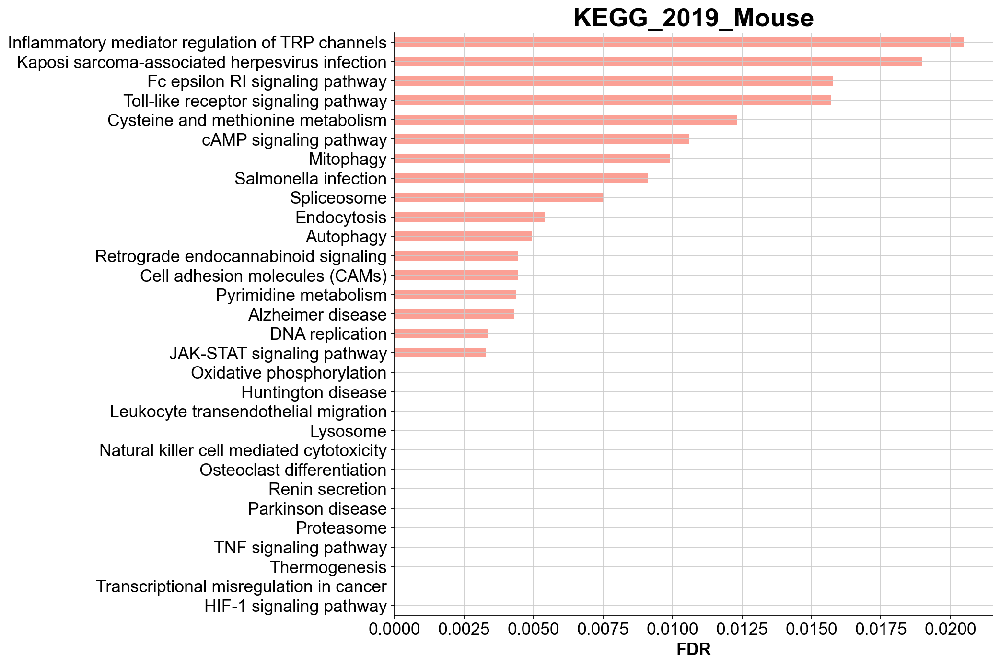

In [17]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN GSEA KEGG.png')

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10))

In [18]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='WikiPathways_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_GSEA_WIKI_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:54:34,117 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,EGFR1 Signaling Pathway WP572,0.515882,2.039816,0.000000,0.000000,178,65,CEBPB;PLSCR1;STAT3;PTK2B;JUND;RPS6KA3;PLEC;PIK...,CEBPB;PLSCR1;STAT3;PTK2B;JUND;RPS6KA3;PLEC;PIK...
1,Electron Transport Chain WP295,-0.638917,-2.284865,0.000000,0.000000,103,73,UCP2;COX7A2L;SDHA;NDUFA6;SDHC;ATP5L;SLC25A4;ND...,NDUFS5;COX4I1;NDUFA5;NDUFA3;NDUFB10;NDUFA1;SDH...
2,IL-2 Signaling Pathway WP450,0.556013,2.049576,0.000000,0.000000,76,35,CD53;STAT3;PTK2B;IL2RG;CISH;PIK3R1;JAK1;PIK3CD...,CD53;STAT3;PTK2B;IL2RG;CISH;PIK3R1;JAK1;PIK3CD...
3,IL-5 Signaling Pathway WP151,0.526999,2.013240,0.000000,0.000000,69,41,PIM1;STAT3;PTK2B;ALOX5AP;SDCBP;PIK3R1;JUN;JAK1...,PIM1;STAT3;PTK2B;ALOX5AP;SDCBP;PIK3R1;JUN;JAK1...
4,Insulin Signaling WP65,0.583987,2.110553,0.000000,0.000000,159,44,MAP4K4;XBP1;SNAP23;RPS6KA3;FLOT1;PIK3R1;JUN;IG...,MAP4K4;XBP1;SNAP23;RPS6KA3;FLOT1;PIK3R1;JUN;IG...
5,Oxidative phosphorylation WP1248,-0.658615,-2.140620,0.000000,0.000000,62,44,ATP6AP2;NDUFA6;ATP5L;NDUFS3;NDUFA11;NDUFS7;NDU...,NDUFS5;NDUFA5;NDUFA3;NDUFB10;NDUFS2;ATP5O;NDUF...
6,ESC Pluripotency Pathways WP339,0.628965,1.948499,0.000000,0.005303,118,22,SMAD7;STAT3;JUN;JAK1;PIK3CD;SMAD1;SELENOP;FOS;...,SMAD7;STAT3;JUN;JAK1;PIK3CD;SMAD1;SELENOP;FOS
7,MicroRNAs in Cardiomyocyte Hypertrophy WP1560,0.600031,1.911878,0.000000,0.005681,82,27,STAT3;CISH;CAMK2D;PIK3R1;PPP3CA;IGF1R;PIK3CD;R...,STAT3;CISH;CAMK2D;PIK3R1;PPP3CA;IGF1R;PIK3CD;R...
8,IL-3 Signaling Pathway WP373,0.522467,1.900392,0.000000,0.006628,100,39,SELP;STAT3;CISH;PIK3R1;JAK1;SPI1;PIK3CD;RAC1;P...,SELP;STAT3;CISH;PIK3R1;JAK1;SPI1;PIK3CD;RAC1;P...
9,TGF Beta Signaling Pathway WP113,0.643741,1.916918,0.000000,0.006628,52,20,SMAD7;STAT3;FKBP1A;ENG;JUN;JAK1;CREBBP;SMAD1;F...,SMAD7;STAT3;FKBP1A;ENG;JUN;JAK1;CREBBP;SMAD1;F...


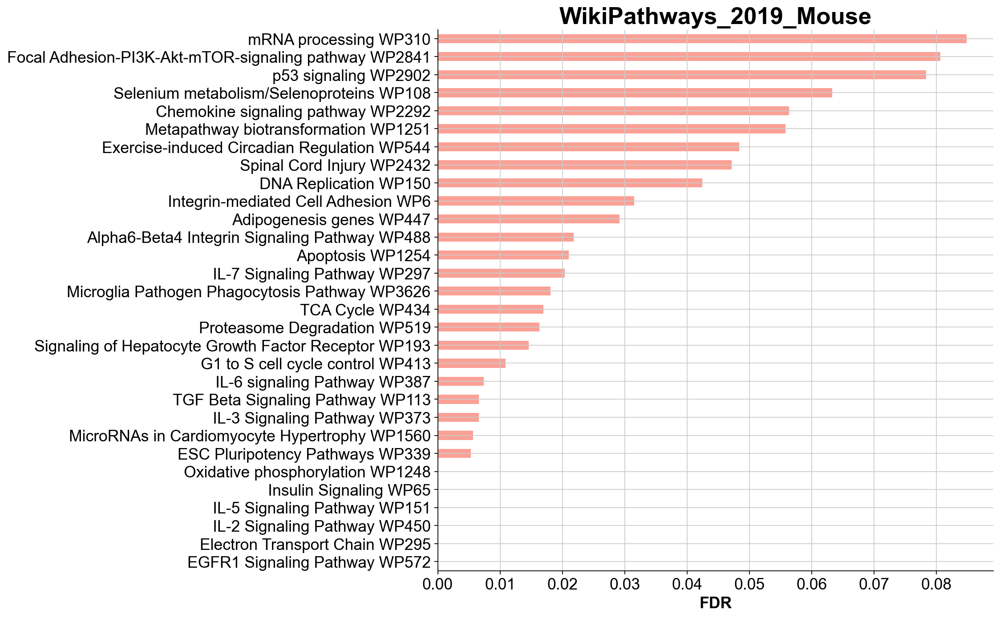

In [19]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN GSEA WIKI.png')

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10))

In [20]:
groups = ['IL10_Old_transplanted', 'DN_Old_transplanted']
IL10_vs_DN_GSEA = Old_transplanted_Ambient_RNA_cleaned_HSC[Old_transplanted_Ambient_RNA_cleaned_HSC.obs.IL10.isin(groups)]

In [21]:
expression_matrix_IL10_vs_DN = pd.DataFrame(IL10_vs_DN_GSEA.X)
expression_matrix_IL10_vs_DN.columns = IL10_vs_DN_GSEA.var.index
expression_matrix_IL10_vs_DN = expression_matrix_IL10_vs_DN.T
gene_list = list(IL10_vs_DN_GSEA.var.index)
column_values = pd.Series(gene_list)
expression_matrix_IL10_vs_DN.insert(loc=0, column='Description', value=column_values)
expression_matrix_IL10_vs_DN.insert(loc=0, column='NAME', value=gene_list)
expression_matrix_IL10_vs_DN['NAME'] = expression_matrix_IL10_vs_DN['NAME'].str.upper()
expression_matrix_IL10_vs_DN.index = range(len(expression_matrix_IL10_vs_DN.index))

In [22]:
phenotype_list_IL10_vs_DN = list(IL10_vs_DN_GSEA.obs.IL10)

In [23]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Biological_Process_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png',)

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_GSEA_GO_BP_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv', index=None)

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:54:53,393 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,mitotic nuclear membrane organization (GO:0101...,-0.682476,-2.168905,0.000000,0.000000,51,22,CHMP4B;PPP2CA;LBR;AHCTF1;EMD;NUP98;VRK1;CHMP2B...,CHMP3;POM121;SUMO1;BANF1;RAN;UBE2I;RANGAP1;CDK...
1,mitotic nuclear membrane reassembly (GO:0007084),-0.682476,-2.168905,0.000000,0.000000,51,22,CHMP4B;PPP2CA;LBR;AHCTF1;EMD;NUP98;VRK1;CHMP2B...,CHMP3;POM121;SUMO1;BANF1;RAN;UBE2I;RANGAP1;CDK...
2,nuclear membrane reassembly (GO:0031468),-0.668113,-2.181647,0.000000,0.000000,54,23,CHMP4B;NSFL1C;PPP2CA;LBR;AHCTF1;EMD;NUP98;VRK1...,CHMP3;POM121;SUMO1;BANF1;RAN;UBE2I;RANGAP1;CDK...
3,mitotic spindle organization (GO:0007052),-0.590946,-2.073831,0.000000,0.010997,157,52,DYNC1H1;TAOK1;MZT1;KIF2A;STAG2;AHCTF1;SBDS;FLN...,PMF1;PPP1CC;MAPRE1;RANBP2;PCNT;BCCIP;DCTN2;XPO...
4,aerobic electron transport chain (GO:0019646),-0.603978,-2.033035,0.022727,0.014662,70,60,NDUFS4;UQCR10;NDUFA2;UQCRQ;SDHA;NDUFB11;SDHC;C...,UQCRB;NDUFA3;NDUFC1;UQCC3;NDUFA5;NDUFA9;NDUFV2...
...,...,...,...,...,...,...,...,...,...
154,Fc receptor signaling pathway (GO:0038093),-0.370274,-1.424500,0.019608,0.227140,112,61,JUN;PPP3CA;FOS;LYN;LCP2;RELA;PIK3R1;NFATC3;NFK...,PSMD14;PSME3;PSMA5;PSMA3;PSMC6;PSMB9;PSMA4;PSM...
155,Fc-epsilon receptor signaling pathway (GO:0038...,-0.372044,-1.421827,0.019231,0.227476,111,60,JUN;PPP3CA;FOS;LYN;LCP2;RELA;PIK3R1;NFATC3;NFK...,PSMD14;PSME3;PSMA5;PSMA3;PSMC6;PSMB9;PSMA4;PSM...
156,proteasome-mediated ubiquitin-dependent protei...,-0.333183,-1.420174,0.017857,0.227933,321,118,CUL5;HSPA5;SEL1L;ITCH;TAF1;UBR2;SELENOS;USP19;...,PSMD6;MTA1;PSMC3;UBE2E1;ANAPC5;UBE2S;UBE2K;CDC...
157,regulation of cell death (GO:0010941),-0.460636,-1.414491,0.022222,0.229657,102,16,APC;CHMP4B;CDKN1B;CELF1;CTSZ;EIF4G1;CHMP2A;SRS...,SOX4;VPS4B;VPS35;UBB;BNIP3L;LRPAP1;HP;PARK7


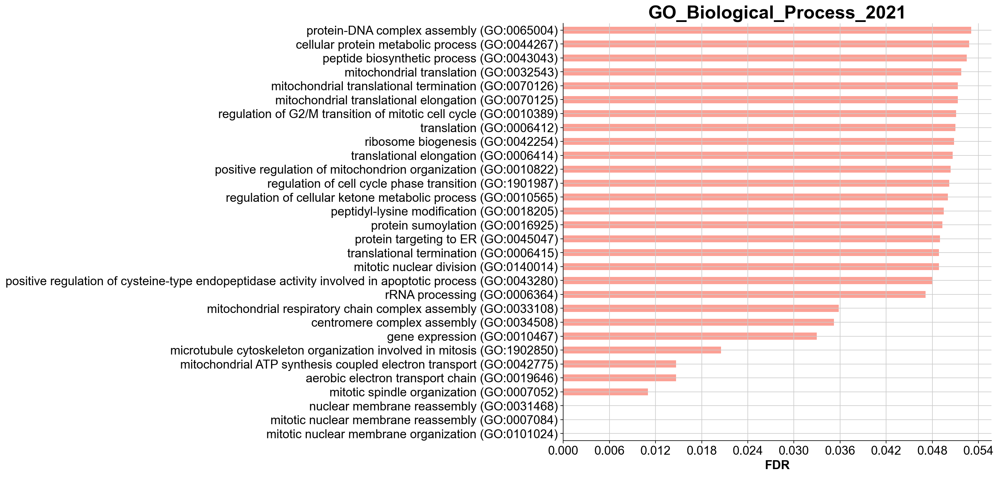

In [24]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN GSEA GO BP.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10))

In [25]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Molecular_Function_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_GSEA_GO_MF_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:55:24,912 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,NADH dehydrogenase (quinone) activity (GO:0050...,-0.654568,-2.013132,0.020000,0.023709,35,33,NDUFS4;NDUFA2;NDUFS5;NDUFS3;NDUFA1;NDUFV3;NDUF...,NDUFA3;NDUFC1;NDUFA5;NDUFA9;NDUFV2;NDUFS2;NDUF...
1,NADH dehydrogenase (ubiquinone) activity (GO:0...,-0.654568,-2.013132,0.020000,0.023709,35,33,NDUFS4;NDUFA2;NDUFS5;NDUFS3;NDUFA1;NDUFV3;NDUF...,NDUFA3;NDUFC1;NDUFA5;NDUFA9;NDUFV2;NDUFS2;NDUF...
2,oxidoreduction-driven active transmembrane tra...,-0.625662,-1.933072,0.000000,0.026343,58,47,NDUFS4;UQCR10;NDUFA2;UQCRQ;COX6B1;CYB5A;NDUFS5...,NDUFA3;NDUFC1;NDUFA5;NDUFA9;NDUFV2;NDUFS2;NDUF...
3,cyclin-dependent protein serine/threonine kina...,-0.617549,-1.667183,0.019608,0.233137,44,15,CCND1;CDKN2D;CDKN1B;CCNL2;CCNT1;CCND3;CCNI;CCN...,CCNL1;CKS2;CKS1B;CCNB2;CCNA2
4,ubiquitin protein ligase binding (GO:0031625),-0.378263,-1.472964,0.022727,0.233137,265,95,NFKBIA;JUN;APC;CUL5;HSPA5;OTUB1;ARIH1;CXCR4;SQ...,SPOP;PSMA3;PA2G4;UBE2L3;PINK1;POLR2A;UBXN1;PCB...
5,GTPase binding (GO:0051020),-0.385731,-1.478985,0.000000,0.234981,201,55,IQGAP1;AKAP13;CYFIP1;OCRL;FNBP1L;BICD1;SPTBN1;...,YBX1;DNM1L;ARHGEF2;RANBP2;GNB2;STOML2;IQGAP2;M...
6,active ion transmembrane transporter activity ...,-0.564363,-1.522342,0.025000,0.239963,42,16,UQCR10;UQCRQ;COX6B1;CYB5A;SLCO3A1;UQCRC1;UQCR1...,COX7A2L;UQCRFS1;UQCRH;NDUFA4;COX5B;COX4I1;COX6...


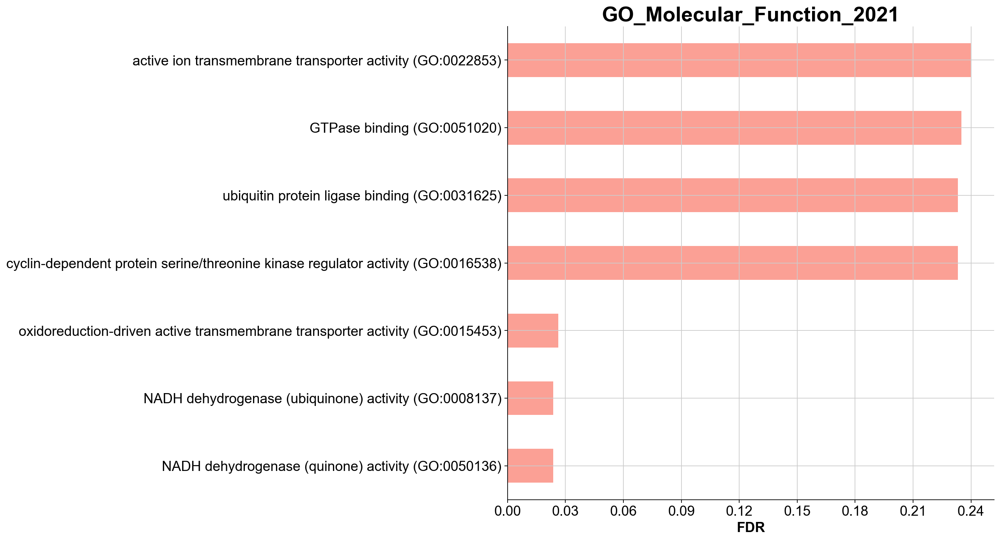

In [26]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN GSEA GO MF.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10))

In [27]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Cellular_Component_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_GSEA_GO_CC_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:55:44,797 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,mitochondrial matrix (GO:0005759),-0.517084,-2.190490,0.000000,0.000000,348,103,GLUD1;MRPL48;DGUOK;SOD1;SSBP1;ECHS1;GOT2;ETFA;...,GCSH;GADD45GIP1;MRPL11;SIRT3;ACAT1;SOD2;MDH2;S...
1,polysomal ribosome (GO:0042788),-0.774383,-2.043002,0.000000,0.000000,30,29,FMR1;DHX9;LARP4B;NUFIP2;LARP1;BTF3;RPL36;RPL19...,BTF3;RPL36;RPL19;RPS28;RPL18A;RPL30;RPL36A;RPS...
2,organelle inner membrane (GO:0019866),-0.530852,-2.013898,0.000000,0.003167,346,162,IMMT;SLC25A1;MRPL4;MRPL48;MRPS7;SMAD1;NDUFS4;U...,MRPL11;YME1L1;CYCS;PINK1;COX5A;NDUFB9;SHMT2;MR...
3,mitochondrial inner membrane (GO:0005743),-0.537940,-2.023103,0.000000,0.003959,328,154,IMMT;SLC25A1;MRPL4;MRPL48;MRPS7;NDUFS4;UQCR10;...,MRPL11;YME1L1;CYCS;PINK1;COX5A;NDUFB9;SHMT2;MR...
4,mitochondrial envelope (GO:0005740),-0.535744,-2.031912,0.000000,0.005279,127,45,SOD1;NDUFA2;TIMM10B;TIMM9;TRAP1;GATM;IFI27;COX...,CYCS;PINK1;CHCHD10;TMEM14C;NDUFAB1;ACADM;DNM1L...
5,mitochondrial membrane (GO:0031966),-0.510683,-1.991952,0.000000,0.005279,469,192,MCL1;HK2;KRAS;IMMT;BCL2;CYB5R3;CASP8;UBC;SLC25...,MRPL11;YME1L1;MFF;CYCS;PINK1;COX5A;NDUFB9;SHMT...
6,mitochondrial intermembrane space (GO:0005758),-0.624955,-1.962581,0.000000,0.013573,58,22,SOD1;TIMM10B;TIMM9;TRAP1;GATM;COX17;CHCHD4;CYC...,CYCS;PINK1;CHCHD10;PRELID1;STOML2;NDUFB7;CHCHD...
7,mitochondrial respiratory chain complex I (GO:...,-0.617639,-1.918037,0.020408,0.015836,42,36,NDUFS4;NDUFA2;NDUFB11;NDUFS5;NDUFS3;NDUFA1;NDU...,NDUFA3;NDUFC1;NDUFA5;NDUFA9;NDUFV2;NDUFS2;NDUF...
8,respiratory chain complex I (GO:0045271),-0.617639,-1.918037,0.020408,0.015836,42,36,NDUFS4;NDUFA2;NDUFB11;NDUFS5;NDUFS3;NDUFA1;NDU...,NDUFA3;NDUFC1;NDUFA5;NDUFA9;NDUFV2;NDUFS2;NDUF...
9,ribosome (GO:0005840),-0.684405,-1.897302,0.040816,0.015836,62,59,SERP1;DNAJC21;MRPS7;FMR1;DHX9;RPS27;LARP4B;NUF...,RPL36;RPL19;RPS28;RPS19;RPL18A;RPL23;RPL30;RPS...


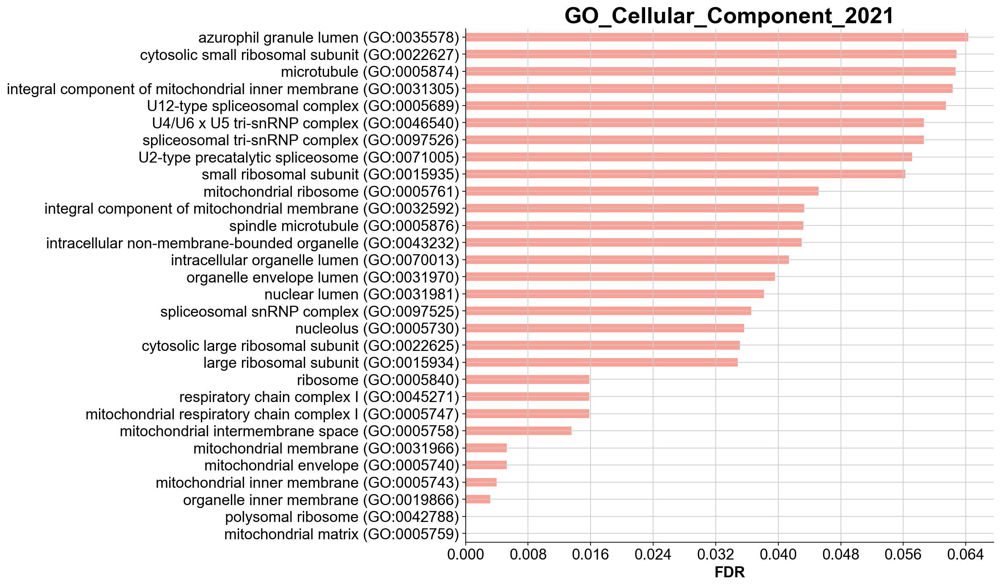

In [28]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN GSEA GO CC.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10))

In [29]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='KEGG_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_GSEA_KEGG_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:56:05,222 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Huntington disease,-0.568019,-2.180424,0.000000,0.000000,192,115,CREB1;TGM2;CLTB;DCTN4;SP1;CASP8;POLR2E;SOD1;GN...,CYCS;POLR2A;POLR2I;COX5A;SOD2;NDUFB9;TFAM;NDUF...
1,Thermogenesis,-0.545780,-2.103631,0.000000,0.010064,231,115,PNPLA2;KRAS;CREB1;ACTB;NRAS;MAP2K3;PRKACB;RPS6...,UQCRB;NDUFA3;NDUFC1;COX20;COX14;ATP5F1;NDUFA5;...
2,Parkinson disease,-0.582141,-2.053229,0.024390,0.010064,144,94,UBA7;PRKACB;NDUFS4;UQCR10;GNAI3;NDUFA2;UBE2J2;...,UBB;NDUFAB1;PPIF;UQCRB;VDAC3;NDUFA3;NDUFC1;ATP...
3,Alzheimer disease,-0.535019,-1.996816,0.000000,0.012077,175,101,PPP3CA;TNFRSF1A;RTN4;CASP8;PSENEN;PPP3CB;RTN3;...,ATP2A2;IDE;CYCS;COX5A;NDUFB9;ADAM10;APH1A;NDUF...
4,Oxidative phosphorylation,-0.612430,-2.064577,0.000000,0.013419,134,87,NDUFS4;UQCR10;NDUFA2;UQCRQ;SDHA;NDUFB11;ATP6V0...,UQCRB;NDUFA3;NDUFC1;ATP5F1;NDUFA5;ATP6V1A;NDUF...
5,Systemic lupus erythematosus,-0.644789,-1.830153,0.000000,0.045847,143,23,ACTN4;H3F3B;SNRPD3;H2-AB1;SSB;H2-DMA;H2-AA;HIS...,H2-DMA;H2-AA;HIST1H4D;H2-DMB1;HIST1H2BC;H2AFJ;...
6,Synaptic vesicle cycle,-0.549409,-1.726535,0.018182,0.048433,77,18,CLTB;SLC18A2;CLTC;ATP6V0D1;ATP6V1E1;ATP6V1F;AT...,ATP6V1A;ATP6V0C;ATP6V1G1;NAPA;AP2B1;AP2S1;CLTA...
7,Non-alcoholic fatty liver disease (NAFLD),-0.488860,-1.871085,0.022222,0.048643,151,84,XBP1;JUN;TNFRSF1A;ITCH;AKT1;RELA;ADIPOR1;PIK3R...,UQCRB;NDUFA3;NDUFC1;NDUFA5;NDUFA9;NDUFV2;NDUFS...
8,Ribosome,-0.681958,-1.840059,0.043478,0.049062,170,117,MRPL4;MRPS7;MRPL28;RPS27;RSL24D1;MRPL2;UBA52;M...,MRPL23;RPL36;RPL35;RPL4;RPL19;RPL14;RPS28;RPS6...
9,Pyrimidine metabolism,-0.657599,-1.771942,0.000000,0.050320,58,15,NT5C3;NT5C;PNP;DCTPP1;NME2;NME1;DTYMK;DUT;CMPK...,DCTPP1;NME2;NME1;DTYMK;DUT;CMPK1;NT5C2;TYMS;NM...


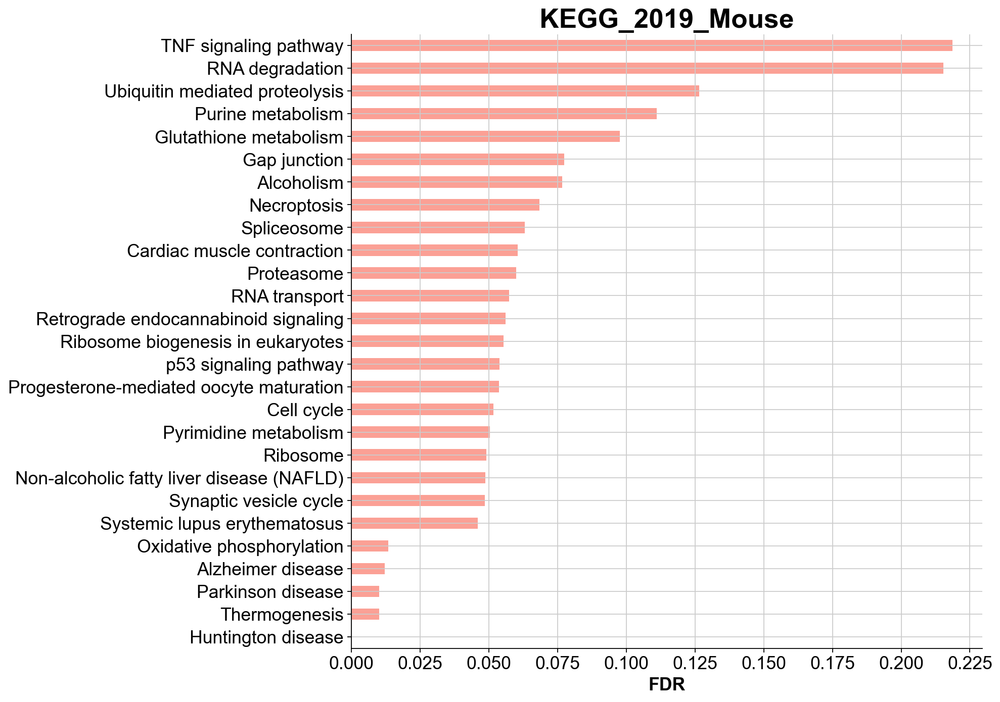

In [30]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN GSEA KEGG.png')

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10))

In [31]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='WikiPathways_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_GSEA_WIKI_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:56:24,219 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Electron Transport Chain WP295,-0.619492,-2.006203,0.000000,0.010923,103,73,NDUFS4;UQCR10;UCP2;NDUFA2;UQCRQ;SDHA;SDHC;COX1...,UQCRB;NDUFA3;NDUFC1;ATP5F1;NDUFA5;NDUFA9;NDUFV...
1,p53 signaling WP2902,-0.545189,-1.754999,0.000000,0.027308,67,20,MDM4;CCND1;RCHY1;CASP8;PTEN;SHISA5;CCND3;SESN3...,TRP53;COP1;CASP3;CDK4;CDK1;BAX;RRM2;CCNB2
2,Oxidative phosphorylation WP1248,-0.627287,-1.885498,0.023256,0.027308,62,44,ATP6AP2;NDUFS4;NDUFA2;ATP5L;ATP5D;NDUFS5;NDUFS...,NDUFA3;NDUFC1;ATP5F1;NDUFA5;NDUFA9;NDUFV2;NDUF...
3,Cytoplasmic Ribosomal Proteins WP163,-0.747513,-1.762674,0.041667,0.032770,92,76,RPS27;RPS6KA3;RPS6KA1;RPL3;RPS24;RPS4X;RPL21;R...,RPL36;RPL35;RPL4;RPL19;RPS28;RPS6;RPS19;RPL18A...
4,Proteasome Degradation WP519,-0.527819,-1.700465,0.000000,0.047334,52,44,UBA7;PSMB6;RPN2;UBE2B;RPN1;PSMD12;PSMD11;PSMB7...,PSME3;PSMA5;NEDD4;PSMA3;PSMC6;PSMB9;PSMA4;PSME...
5,mRNA processing WP310,-0.392497,-1.712642,0.019231,0.054616,457,244,CIRBP;CLK1;RBMS1;DICER1;TTC14;ATXN1;SMN1;HNRNP...,ACIN1;SRSF9;RPS24;NIP7;FBL;PTBP3;NCL;ZMAT2;SSB...
6,Translation Factors WP307,-0.425414,-1.538761,0.044444,0.113328,50,38,EIF2S3Y;EIF4G3;EIF1;EIF5;EIF4EBP1;EIF4E;EIF3A;...,EIF2S2;EEF2;EIF3E;EIF2S3X;EIF4A1;EIF4B;EEF1A1;...
7,TNF-alpha NF-kB Signaling Pathway WP246,-0.376204,-1.494280,0.037736,0.150497,187,94,NFKBIA;CFLAR;TNFRSF1A;AKT1;TRPC4AP;ZFAND5;FKBP...,PSMD6;COMMD1;SMARCC1;PSMC3;PTPN11;GSK3B;FBL;MC...
8,Amino Acid metabolism WP662,-0.401512,-1.420867,0.018519,0.205356,95,34,GLUL;GLUD1;FH1;VARS;ACLY;GOT2;CS;PKM;HADH;SDHA...,MDH2;SUCLG1;ACO2;ACADM;EPRS;HIBADH;GSR;RARS;OD...


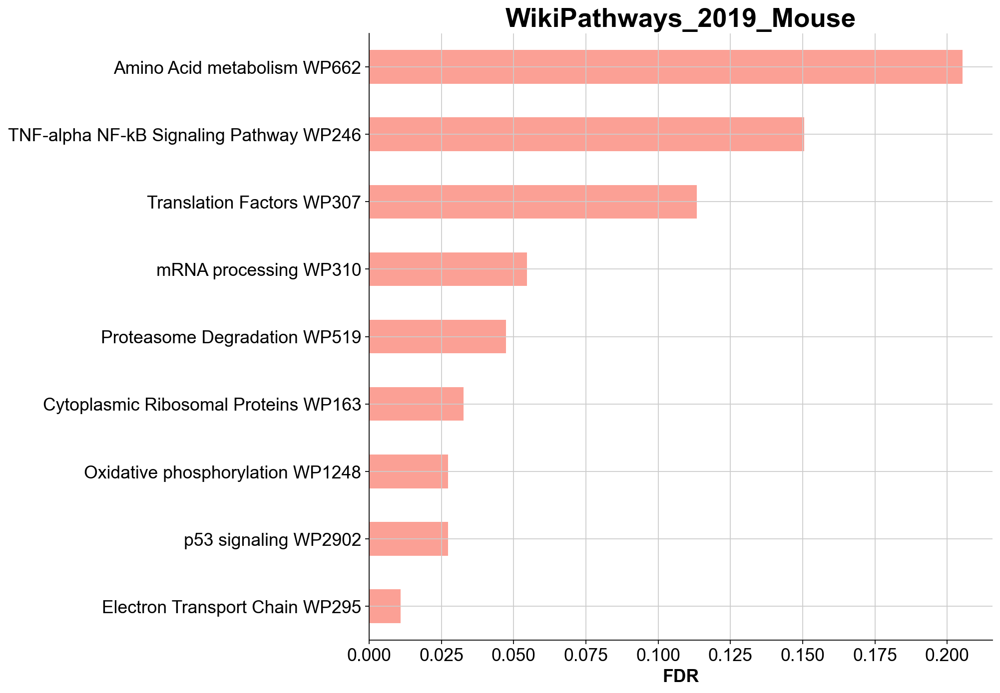

In [32]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN GSEA WIKI.png')

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10))

In [33]:
groups = ['IL10_Old_transplanted', 'IL10ra_Old_transplanted']
IL10_vs_IL10ra_GSEA = Old_transplanted_Ambient_RNA_cleaned_HSC[Old_transplanted_Ambient_RNA_cleaned_HSC.obs.IL10.isin(groups)]

In [34]:
expression_matrix_IL10_vs_IL10ra = pd.DataFrame(IL10_vs_IL10ra_GSEA.X)
expression_matrix_IL10_vs_IL10ra.columns = IL10_vs_IL10ra_GSEA.var.index
expression_matrix_IL10_vs_IL10ra = expression_matrix_IL10_vs_IL10ra.T
gene_list = list(IL10_vs_IL10ra_GSEA.var.index)
column_values = pd.Series(gene_list)
expression_matrix_IL10_vs_IL10ra.insert(loc=0, column='Description', value=column_values)
expression_matrix_IL10_vs_IL10ra.insert(loc=0, column='NAME', value=gene_list)
expression_matrix_IL10_vs_IL10ra['NAME'] = expression_matrix_IL10_vs_IL10ra['NAME'].str.upper()
expression_matrix_IL10_vs_IL10ra.index = range(len(expression_matrix_IL10_vs_IL10ra.index))

In [35]:
phenotype_list_IL10_vs_IL10ra = list(IL10_vs_IL10ra_GSEA.obs.IL10)

In [36]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Biological_Process_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png',)

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_GSEA_GO_BP_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv', index=None)

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:56:41,155 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,ribonucleoprotein complex biogenesis (GO:0022613),-0.563685,-1.765411,0.040816,0.166974,60,35,RIOK1;RBIS;WDR12;NOC2L;EBNA1BP2;PAK1IP1;NOP16;...,MRPL36;TGS1;RPS19;RPS6;RPL14;RPS17;RPS7;NPM1;M...
1,regulation of mitotic cell cycle phase transit...,-0.439107,-1.766658,0.000000,0.174443,188,89,ZFP36L1;PSMB6;PRKAR2B;ZFP36L2;DYNC1H1;CETN2;HA...,PSMB1;PSMD1;PSMD8;DYNC1I2;ANAPC16;ID2;PSMB8;XP...
2,cotranslational protein targeting to membrane ...,-0.643398,-1.771292,0.043478,0.180876,94,89,SEC63;SRP19;SEC61A1;SSR1;UBA52;RPL21;TRAM1;SRP...,RPS19;RPS8;RPL39;RPL12;RPS26;RPS6;SSR2;RPL14;R...
3,cellular protein-containing complex assembly (...,-0.448970,-1.707240,0.000000,0.181132,168,59,SMAD4;TGFB1;CYBA;PSMG2;POMP;RTN4;SRP19;TBCA;CL...,CHMP3;PSMD4;VAMP8;CENPW;HSP90AA1;RAB5IF;CLTA;A...
4,mitochondrion organization (GO:0007005),-0.455575,-1.708870,0.000000,0.185133,175,60,ATAD3A;SSBP1;HSD17B10;PARP1;MTFR1L;HK2;SLC25A3...,YME1L1;TIMM8B;BCAP31;TIMM17A;SIRT3;HSPD1;TFAM;...
5,NADH dehydrogenase complex assembly (GO:0010257),-0.501220,-1.725242,0.032787,0.188073,58,39,NDUFA2;NDUFS4;NDUFS8;NDUFV3;NDUFA1;NDUFS5;NDUF...,NDUFC2;DMAC1;NDUFC1;NDUFV1;NDUFA9;NDUFB7;NDUFA...
6,mitochondrial respiratory chain complex I asse...,-0.501220,-1.725242,0.032787,0.188073,58,39,NDUFA2;NDUFS4;NDUFS8;NDUFV3;NDUFA1;NDUFS5;NDUF...,NDUFC2;DMAC1;NDUFC1;NDUFV1;NDUFA9;NDUFB7;NDUFA...
7,negative regulation of protein modification by...,-0.550876,-1.694514,0.024390,0.188114,55,21,AKT1;VPS28;N4BP1;OGT;SQSTM1;IVNS1ABP;SOX4;ARRB...,COPS9;RPS3;RPL5;RPL11;SMAD7;PARK7;SVBP
8,peptide biosynthetic process (GO:0043043),-0.629202,-1.860317,0.042553,0.188259,162,114,MRPS7;MRPL28;RSL24D1;MRPS36;PABPC4;COPS5;MRPL4...,RPS11;RPL17;MRPL18;RPL41;EEF1A1;MRPL36;RPS19;R...
9,mitochondrial translation (GO:0032543),-0.455440,-1.697787,0.000000,0.189983,105,56,MRPL4;MRPL48;MRPS7;MRPS23;MRPL28;MRPL54;MRPS36...,MRPS15;MRPL34;LARS2;MRPS21;GADD45GIP1;MRPL19;M...


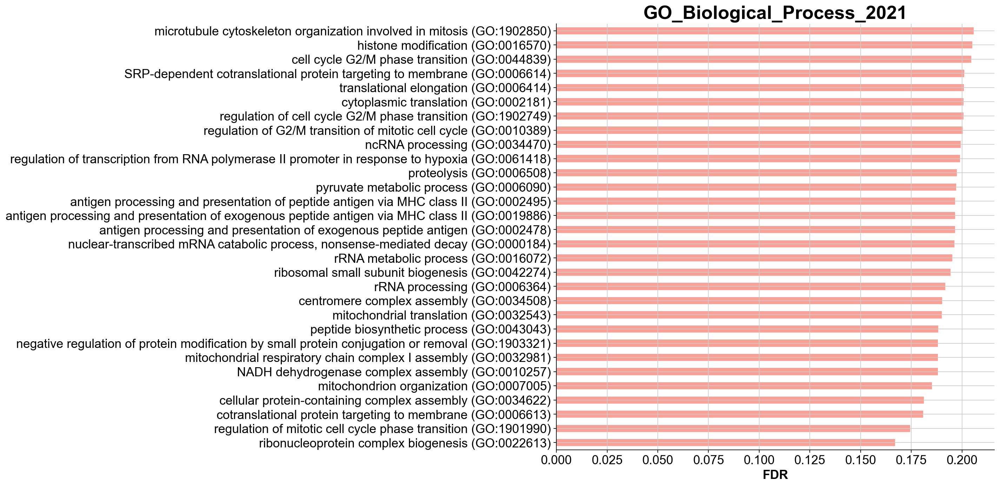

In [37]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs IL10ra GSEA GO BP.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10))

In [38]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Molecular_Function_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_GSEA_GO_MF_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:56:58,630 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,oxidoreduction-driven active transmembrane tra...,-0.517731,-1.722567,0.035714,0.161943,58,47,UQCR10;UQCRQ;NDUFA2;NDUFS4;UQCR11;UQCRC1;COX5A...,NDUFV1;NDUFA9;NDUFB7;NDUFA3;NDUFV2;NDUFS2;NDUF...
1,NADH dehydrogenase (quinone) activity (GO:0050...,-0.530240,-1.732993,0.000000,0.204852,35,33,NDUFA2;NDUFS4;NDUFS8;NDUFV3;NDUFA1;NDUFS5;NDUF...,NDUFC1;NDUFV1;NDUFA9;NDUFB7;NDUFA3;NDUFV2;NDUF...
2,NADH dehydrogenase (ubiquinone) activity (GO:0...,-0.530240,-1.732993,0.000000,0.204852,35,33,NDUFA2;NDUFS4;NDUFS8;NDUFV3;NDUFA1;NDUFS5;NDUF...,NDUFC1;NDUFV1;NDUFA9;NDUFB7;NDUFA3;NDUFV2;NDUF...


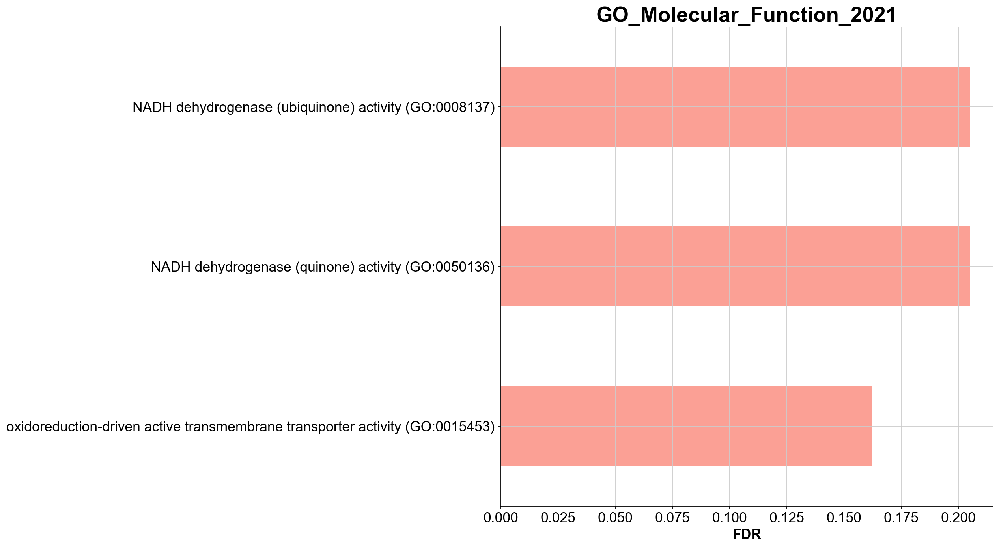

In [39]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs IL10ra GSEA GO MF.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10))

In [40]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Cellular_Component_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_GSEA_GO_CC_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:57:04,541 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,cytoplasmic vesicle lumen (GO:0060205),-0.456813,-1.790484,0.018868,0.077730,115,61,DBNL;CYFIP1;NFKB1;MIF;CSTB;S100A9;PSMD12;S100A...,PSMD7;COTL1;HMGB1;PPIA;PGAM1;EEF1A1;PNP;ALDOA;...
1,mitochondrial inner membrane (GO:0005743),-0.429226,-1.735259,0.000000,0.087759,328,154,IMMT;MRPL4;MRPL48;SLC25A1;UQCR10;MRPS7;UQCRQ;M...,MRPS15;MRPL34;NDUFA4;MRPS21;SHMT2;NDUFC2;DMAC1...
2,organelle inner membrane (GO:0019866),-0.419546,-1.719377,0.000000,0.087759,346,162,IMMT;MRPL4;MRPL48;SLC25A1;UQCR10;MRPS7;UQCRQ;M...,MRPS15;MRPL34;NDUFA4;MRPS21;SHMT2;NDUFC2;MATR3...
3,mitochondrial matrix (GO:0005759),-0.431015,-1.791944,0.000000,0.090684,348,103,GOT2;MRPL48;SSBP1;ECHS1;OXCT1;DGUOK;MRPL28;ETF...,SIRT3;HSPD1;TFAM;NDUFS2;MRPL57;OGDH;NAXD;MRPL1...
4,ribosome (GO:0005840),-0.593084,-1.754533,0.041667,0.091660,62,59,SERP1;MRPS7;DNAJC21;FMR1;DHX9;LARP4B;APEX1;GCN...,RPS13;RPL18A;MRPS12;RPS17;RPS7;RPL19;RPL27;RPL...
5,vacuolar lumen (GO:0005775),-0.457470,-1.738164,0.000000,0.096535,161,49,TXNDC5;CD74;FUCA1;ATP13A2;CYB5R3;MAN2B1;ACLY;M...,ACTR2;PSMD1;CTSL;LAMP2;GDI2;HSPA8;NPC2;GAA;HSP...
6,small ribosomal subunit (GO:0015935),-0.670055,-1.801043,0.019608,0.098290,45,37,RPS27L;EIF2A;UBA52;RPS4X;RPS24;RPS27;RPS11;MRP...,RPS24;RPS27;RPS11;MRPS9;RPS19;RPS8;RPS26;RPS6;...
7,mitochondrial membrane (GO:0031966),-0.413364,-1.759690,0.000000,0.098729,469,192,KRAS;BCL2;IMMT;MRPL4;MRPL48;SLC25A1;UQCR10;MRP...,MRPS15;VPS13A;MRPL34;NDUFA4;MRPS21;SHMT2;NDUFC...
8,mitochondrial envelope (GO:0005740),-0.464895,-1.660850,0.018868,0.114087,127,45,NDUFA2;SOD1;TIMM9;TRAP1;NDUFA1;TIMM10B;COX17;G...,NDUFA9;TMEM14C;NDUFB7;VDAC1;OGDH;PRELID1;STOML...
9,clathrin-coated vesicle (GO:0030136),-0.611192,-1.861807,0.000000,0.117012,80,19,OCRL;CLTB;FCHO2;SPG21;VWF;PICALM;RAB8A;CLTC;RA...,SNX3;TMED9;CLTA;AP2S1;AP2B1;UNC13D;AP2M1


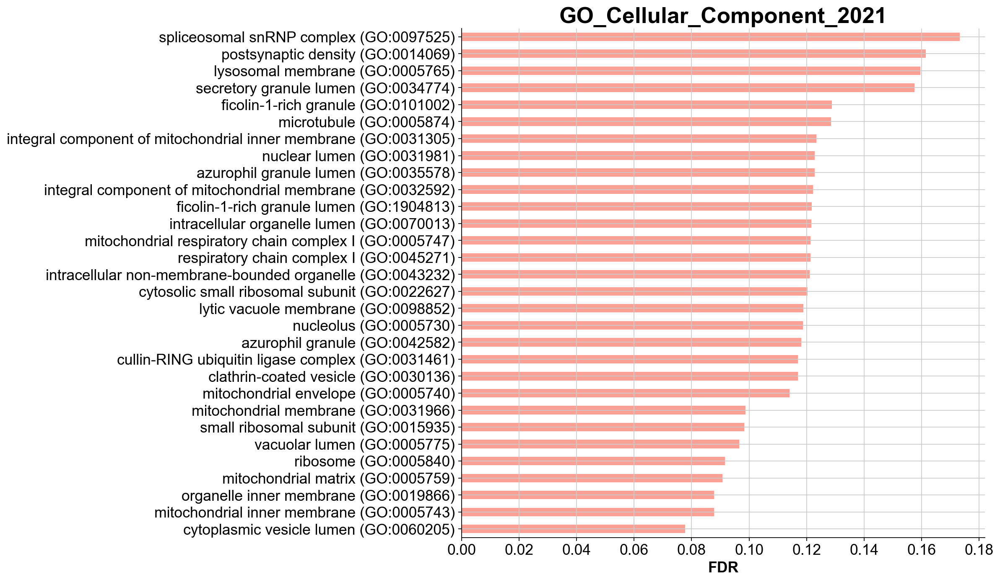

In [41]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs IL10ra GSEA GO CC.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10))

In [42]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='KEGG_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_GSEA_KEGG_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:57:10,898 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Synaptic vesicle cycle,-0.595548,-1.817226,0.000000,0.076210,77,18,CLTB;ATP6V1F;SLC18A2;CLTC;ATP6V1E1;ATP6V0D1;AT...,NAPA;ATP6V1G1;ATP6V0C;ATP6V1A;CLTA;AP2S1;AP2B1...
1,Alzheimer disease,-0.463226,-1.827313,0.000000,0.088912,175,101,PPP3CB;UQCR10;PPP3CA;UQCRQ;CASP8;RTN4;NDUFA2;M...,NDUFB7;ATP5F1;NDUFA3;NDUFV2;GAPDH;NDUFS2;NDUFA...
2,Drug metabolism,-0.615275,-1.791930,0.000000,0.088912,114,18,MGST2;HPRT;GSTM5;NME1;NME2;MGST1;ADH5;GMPS;GUS...,IMPDH2;NME4;CMPK1;GSTM1;RRM1;GSTO1;TK1;RRM2
3,Parkinson disease,-0.463398,-1.752919,0.016129,0.105243,144,94,UBA7;UQCR10;UQCRQ;PRKACB;NDUFA2;NDUFS4;UBE2J2;...,NDUFB7;ATP5F1;VDAC1;NDUFA3;NDUFV2;NDUFS2;NDUFA...
4,Oxidative phosphorylation,-0.480455,-1.831406,0.000000,0.114315,134,87,UQCR10;UQCRQ;NDUFA2;NDUFS4;UQCR11;UQCRC1;COX5A...,NDUFB7;ATP5F1;ATP6V0E;NDUFA3;NDUFV2;NDUFS2;NDU...
5,Glutathione metabolism,-0.602853,-1.708670,0.036364,0.141307,64,17,MGST2;GSTM5;SRM;LAP3;GCLM;IDH2;MGST1;PGD;ODC1;...,GSTM1;RRM1;GSTO1;GSR;GPX1;RRM2
6,Systemic lupus erythematosus,-0.569074,-1.683313,0.000000,0.149598,143,23,SNRPD3;H2-AB1;H2-AA;H2-EB1;H2-DMA;SSB;ACTN4;H2...,H2AFZ;H2AFY;H2AFV;H2-DMB1;HIST1H2BC;SNRPD1;HIS...
7,Thermogenesis,-0.413308,-1.672756,0.000000,0.157501,231,115,ACTB;KRAS;CREB1;UQCR10;PNPLA2;ACTL6A;UQCRQ;PRK...,NDUFV1;NDUFA9;GNAS;NDUFB7;ATP5F1;NDUFA3;NDUFV2...
8,Ribosome,-0.617708,-1.835603,0.043478,0.165122,170,117,MRPL4;MRPS7;MRPL28;RSL24D1;RPS27L;MRPL2;UBA52;...,RPS11;RPL17;MRPL18;MRPS9;RPL41;MRPL36;RPS19;RP...
9,Cardiac muscle contraction,-0.548999,-1.648966,0.000000,0.168586,78,26,UQCR10;UQCRQ;TPM1;UQCR11;UQCRC1;COX5A;COX6B1;A...,ATP1B3;TPM3;UQCRH;COX7C;ATP2A2;COX7B;COX7A2;UQ...


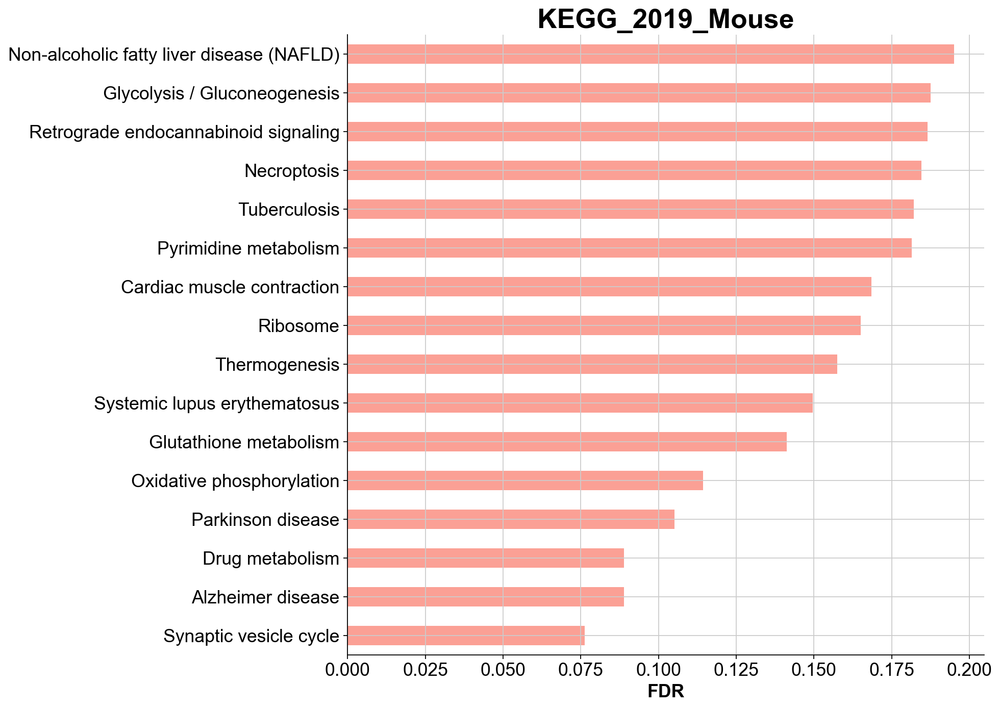

In [43]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs IL10ra GSEA KEGG.png')

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10))

In [44]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='WikiPathways_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_GSEA_WIKI_join_inner_outer_200_3_10_5_scrublet_2_UMI_5_percent_regress_combat.csv')

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 12:57:16,223 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Electron Transport Chain WP295,-0.467546,-1.670532,0.016667,0.142903,103,73,UQCR10;UQCRQ;NDUFA2;NDUFS4;UQCR11;UQCRC1;COX5A...,NDUFV1;NDUFA9;NDUFB7;ATP5F1;NDUFA3;NDUFV2;NDUF...
1,TNF-alpha NF-kB Signaling Pathway WP246,-0.398071,-1.680615,0.000000,0.176246,187,94,NFKBIA;TRPC4AP;AKT1;CFLAR;CD3EAP;ACTL6A;CASP8;...,YWHAB;YWHAG;GSK3B;PSMC1;PSMD7;PML;RPS11;SMARCB...


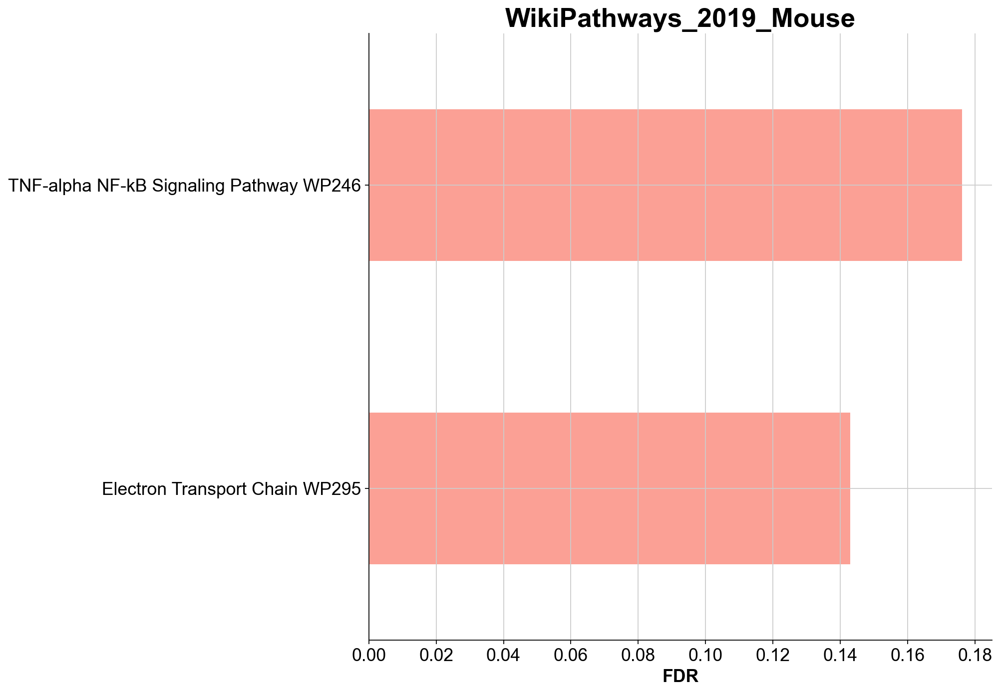

In [45]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs IL10ra GSEA WIKI.png')

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10))

In [3]:
sc.tl.rank_genes_groups(Old_transplanted_Ambient_RNA_cleaned_HSC, 'IL10', groups = ['IL10ra_Old_transplanted'], reference = 'DN_Old_transplanted', method='wilcoxon', corr_method='bonferroni', key_added = 'wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN', use_raw=False)
result = Old_transplanted_Ambient_RNA_cleaned_HSC.uns['wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals', 'pvals_adj']}).head(10)

Trying to set attribute `._uns` of view, copying.
/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


,IL10ra_Old_transplanted_n,IL10ra_Old_transplanted_p
0,Cd53,3.076347e-89
1,Ifitm1,8.620579e-88
2,Alcam,1.031962e-73
3,Sult1a1,6.899344e-70
4,Pim1,3.875423e-64
5,Samsn1,5.318232e-55
6,Gda,2.120393e-53
7,Trim47,3.552583e-50
8,Tmem158,7.460672e-50
9,Tmem176a,1.984075e-49


In [47]:
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC = sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group=None, key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN')
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_DGE_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [48]:
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered = volcano_Old_transplanted_Ambient_RNA_cleaned_HSC[volcano_Old_transplanted_Ambient_RNA_cleaned_HSC['pvals_adj'] < 0.05]
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['pvals_adj'])
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.reset_index(inplace=True, drop=True)
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_005_DGE_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered

/tmp/ipykernel_1224000/2555282522.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['pvals_adj'])


,names,scores,logfoldchanges,pvals,pvals_adj,log_pvals_adj
0,Cd53,20.429462,NaN,9.150348e-93,3.076347e-89,88.511965
1,Ifitm1,20.266054,1.984704,2.564122e-91,8.620579e-88,87.064464
2,Alcam,18.602451,4.522673,3.069489e-77,1.031962e-73,72.986336
3,Sult1a1,18.124224,3.195111,2.052155e-73,6.899344e-70,69.161192
4,Pim1,17.380831,2.925301,1.152713e-67,3.875423e-64,63.411681
...,...,...,...,...,...,...
467,Rpl28,-9.841565,NaN,7.454174e-23,2.506093e-19,18.601003
468,Ppia,-10.045111,4.923236,9.653881e-24,3.245635e-20,19.488700
469,Car2,-10.160249,NaN,2.983136e-24,1.002930e-20,19.998729
470,Ramp1,-10.910163,NaN,1.030719e-27,3.465277e-24,23.460262


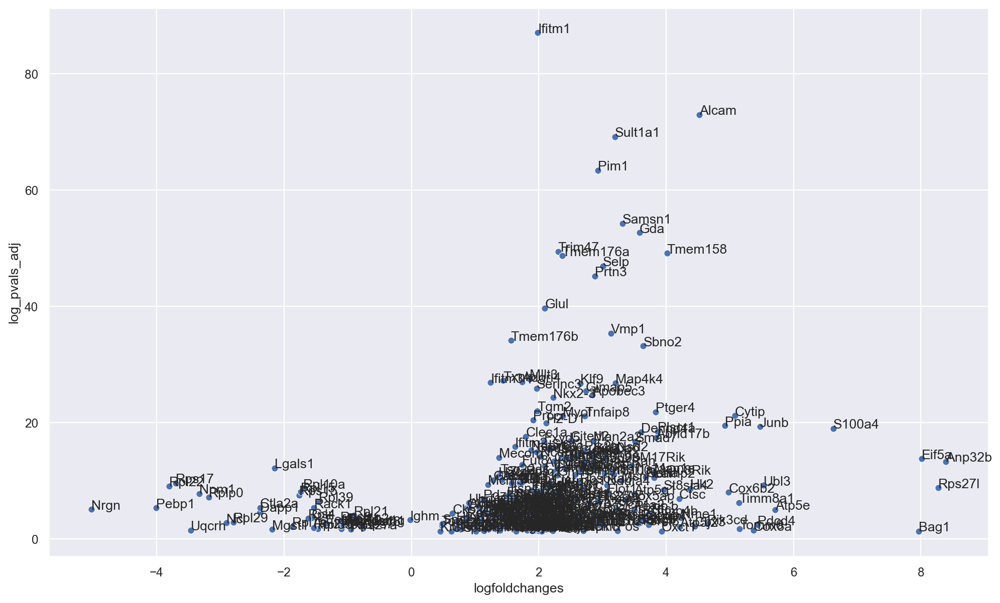

In [49]:
import matplotlib.pylab as plt
from matplotlib.pyplot import rc_context
import seaborn as sns
sc.settings.set_figure_params(dpi=80, facecolor='white')

sns.set(rc={"figure.figsize":(15, 9)})

sns.scatterplot(data=volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered, x='logfoldchanges', y= 'log_pvals_adj')
for line in range(0,volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.shape[0]):
     plt.text(volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.logfoldchanges[line], volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.log_pvals_adj[line], volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.names[line])
plt.show()

In [50]:
import gseapy
gene_set_names = gseapy.get_library_name(organism='Mouse')

In [51]:
glist_Old_transplanted = sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group='IL10ra_Old_transplanted', key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN', pval_cutoff=0.05, log2fc_min=0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_transplanted_Ambient_RNA_cleaned_process = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_upregulated_DGEs_GO_BP_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [4]:
sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group='IL10ra_Old_transplanted', key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN', pval_cutoff=0.05, log2fc_min=0.000000000001).shape

(300, 5)

In [52]:
significant_terms.shape

(50, 10)

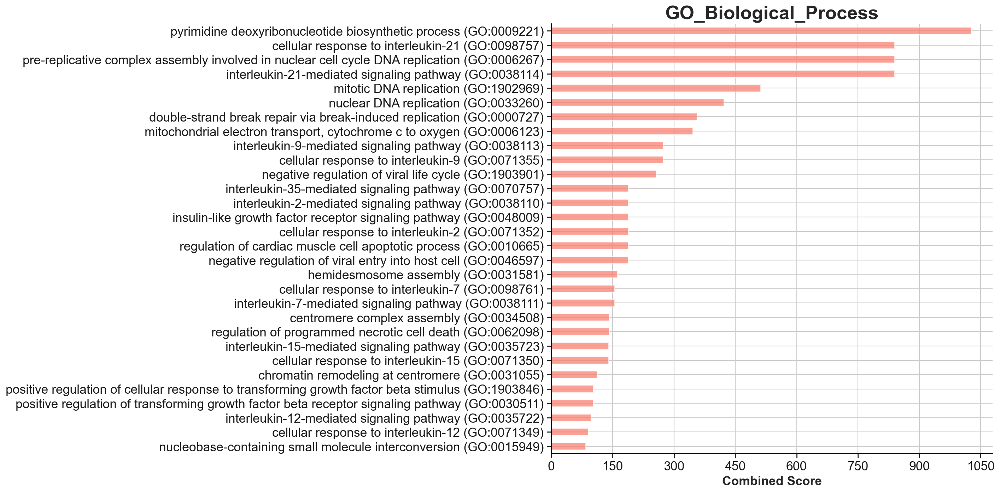

In [53]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Upregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [54]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_function = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_upregulated_DGEs_GO_MF_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [55]:
significant_terms.shape

(4, 10)

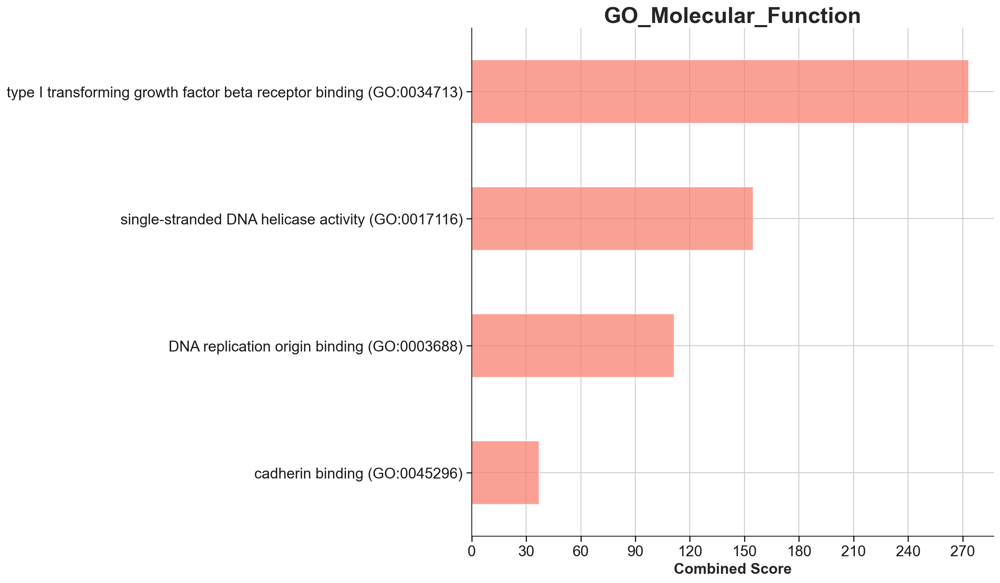

In [56]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Upregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [57]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_upregulated_DGEs_GO_CC_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [58]:
significant_terms.shape

(16, 10)

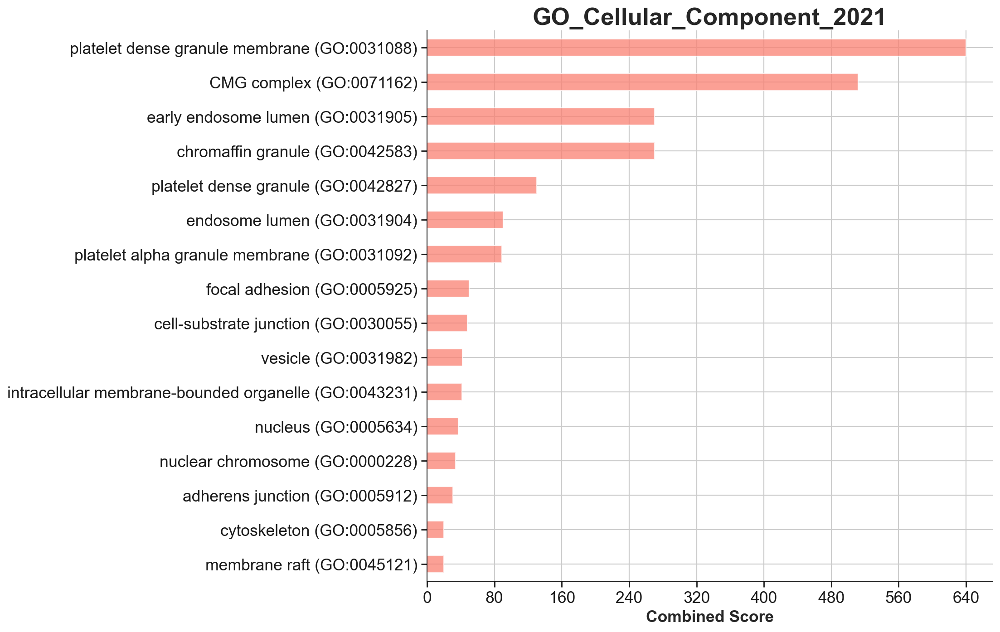

In [59]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Upregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [60]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_upregulated_DGEs_KEGG_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [61]:
significant_terms.shape

(55, 10)

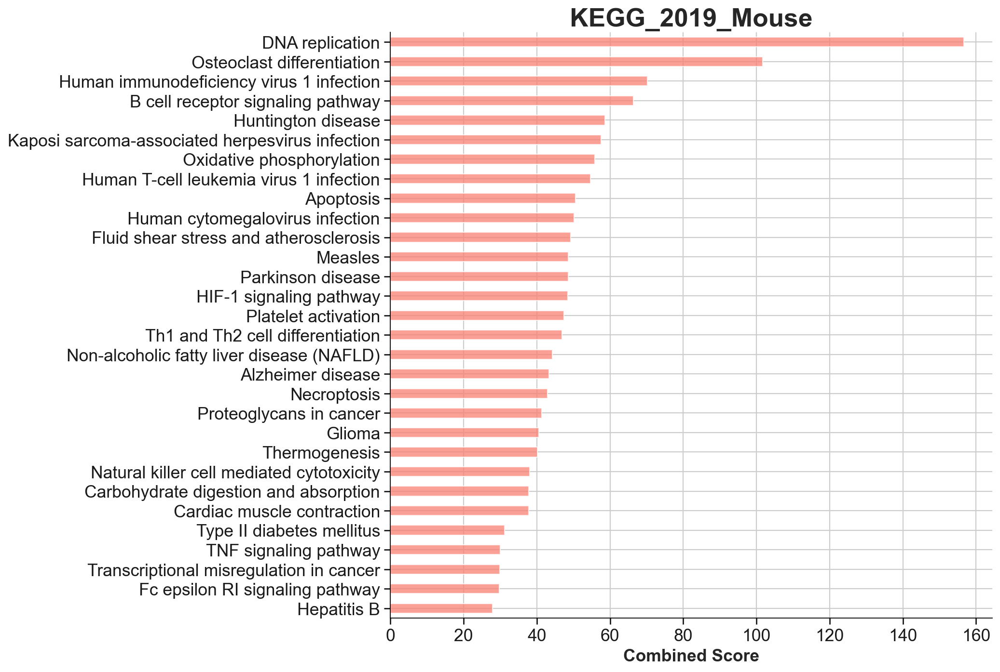

In [62]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Upregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [63]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_upregulated_DGEs_WIKI_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [64]:
significant_terms.shape

(24, 10)

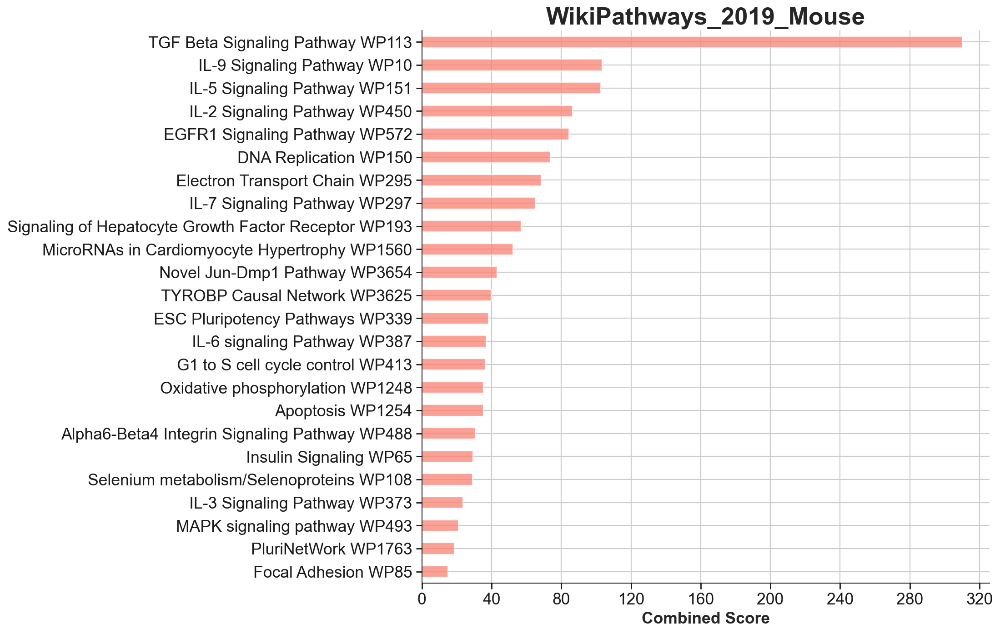

In [65]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Upregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

In [66]:
glist_Old_transplanted = sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group='IL10ra_Old_transplanted', key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN', pval_cutoff=0.05, log2fc_max=-0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_transplanted_Ambient_RNA_cleaned_process = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_downregulated_DGEs_GO_BP_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [67]:
significant_terms.shape

(47, 10)

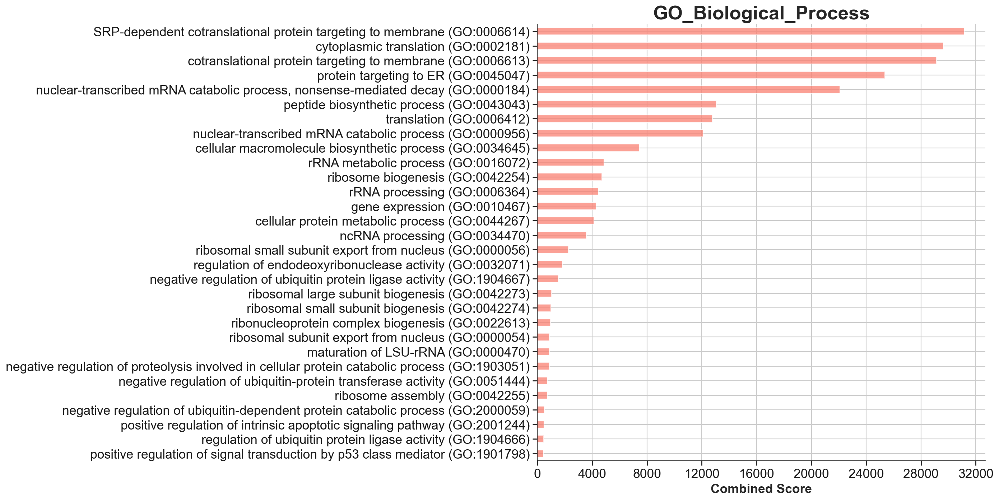

In [68]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Downregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [69]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_function = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_downregulated_DGEs_GO_MF_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [70]:
significant_terms.shape

(10, 10)

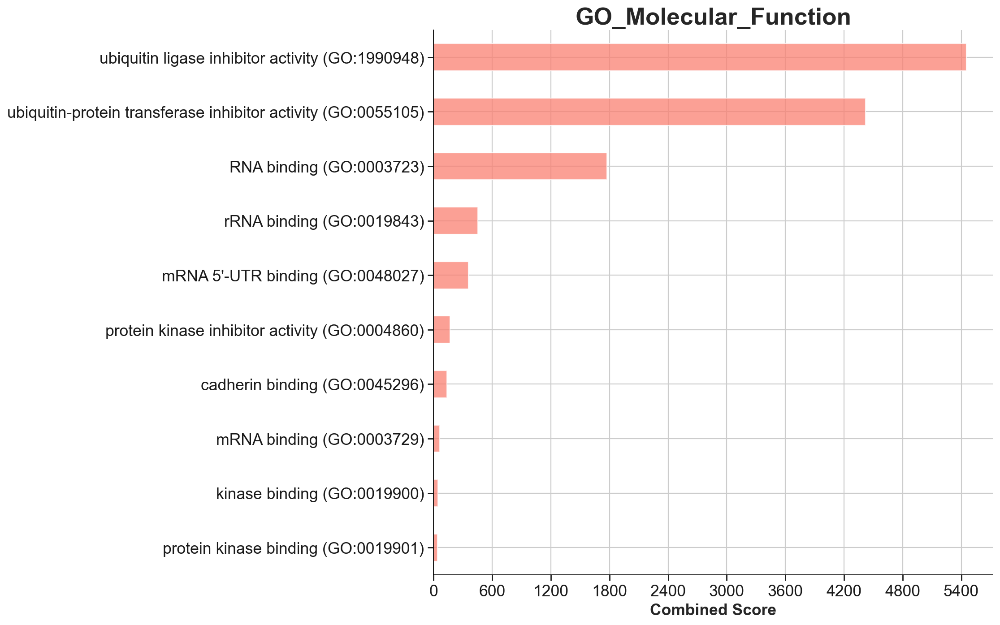

In [71]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Downregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [72]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_downregulated_DGEs_GO_CC_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [73]:
significant_terms.shape

(16, 10)

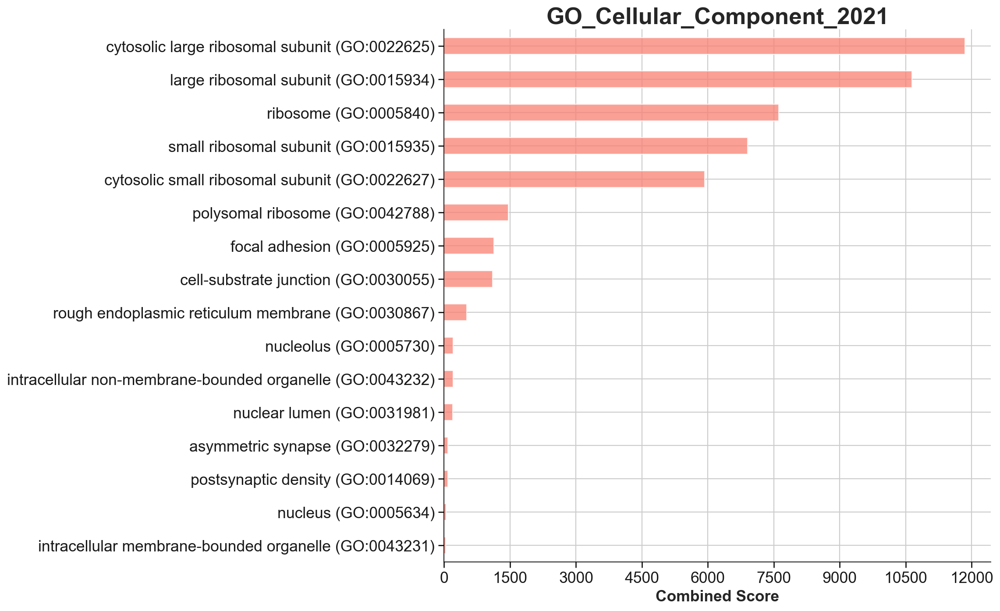

In [74]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Downregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [75]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_downregulated_DGEs_KEGG_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [76]:
significant_terms.shape

(1, 10)

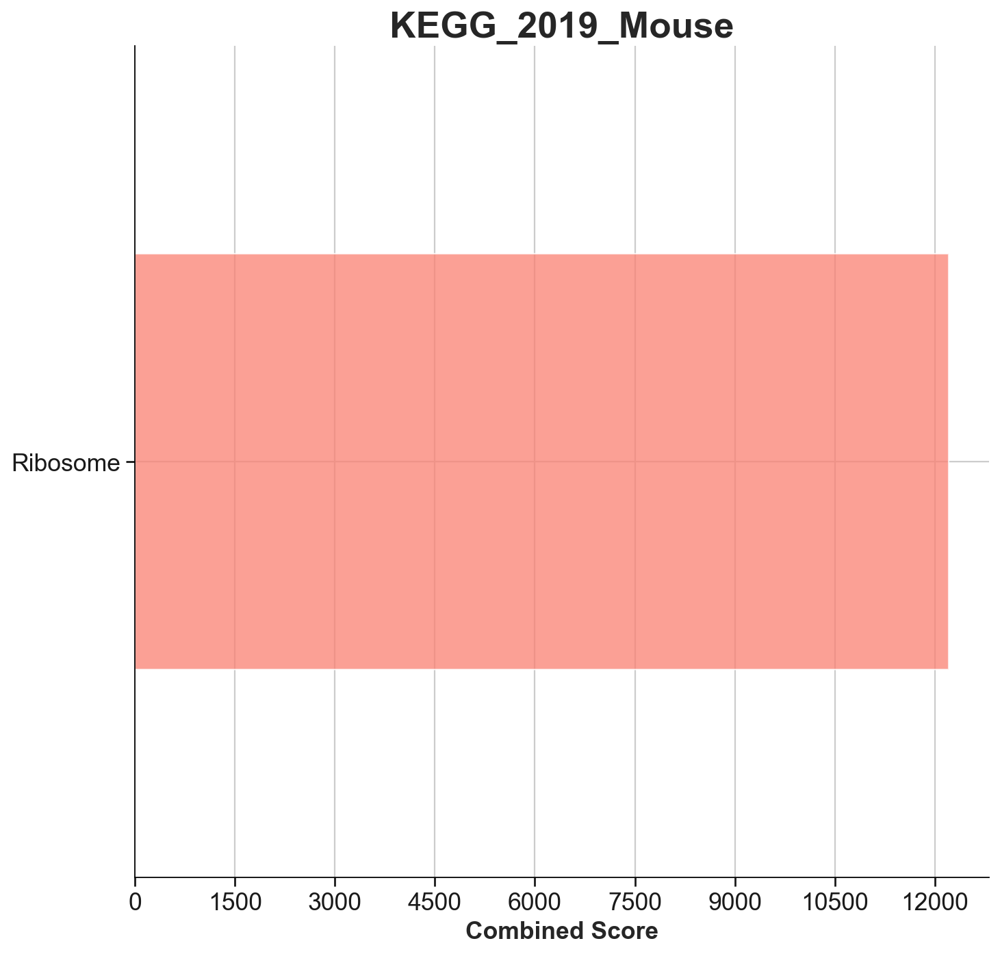

In [77]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Downregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [78]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10ra_vs_DN_significantly_downregulated_DGEs_WIKI_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [79]:
significant_terms.shape

(5, 10)

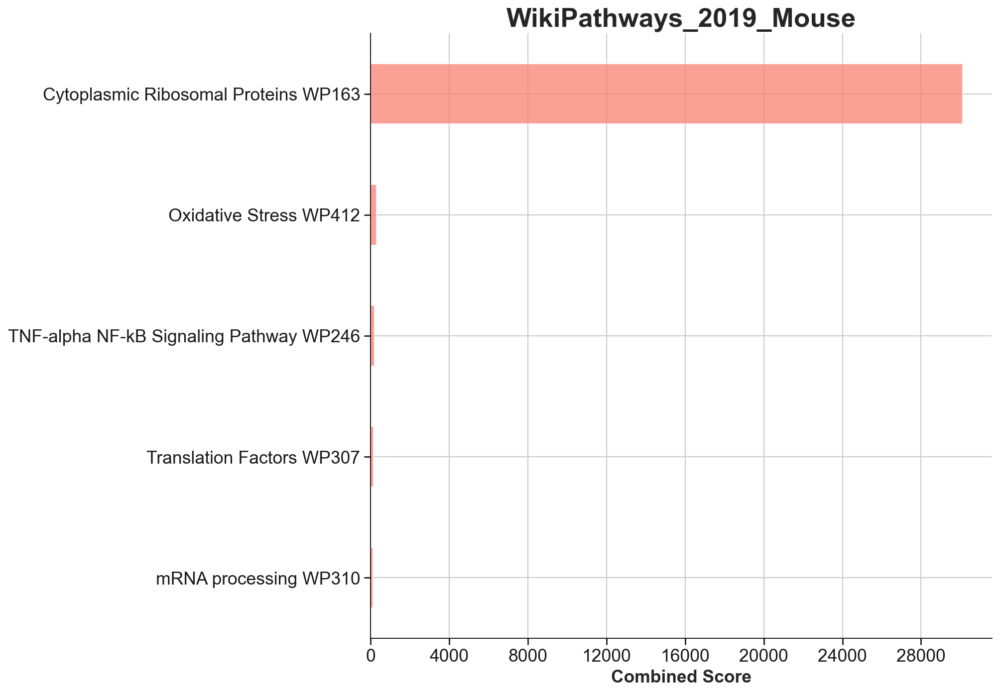

In [80]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10ra vs DN Downregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

In [81]:
sc.tl.rank_genes_groups(Old_transplanted_Ambient_RNA_cleaned_HSC, 'IL10', groups = ['IL10_Old_transplanted'], reference = 'DN_Old_transplanted', method='wilcoxon', corr_method='bonferroni', key_added = 'wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN', use_raw=False)
result = Old_transplanted_Ambient_RNA_cleaned_HSC.uns['wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals', 'pvals_adj']}).head(10)

,IL10_Old_transplanted_n,IL10_Old_transplanted_p
0,Cldn5,0.020059
1,Klf2,0.420152
2,Gm10419,0.945778
3,Igha,1.000000
4,Coro2a,1.000000
5,Stk17b,1.000000
6,Igkc,1.000000
7,Pim1,1.000000
8,Xbp1,1.000000
9,Cytip,1.000000


In [82]:
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC = sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group=None, key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN')
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_DGE_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_regress_combat_raw_SingleR_beforehand.csv")

In [83]:
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered = volcano_Old_transplanted_Ambient_RNA_cleaned_HSC[volcano_Old_transplanted_Ambient_RNA_cleaned_HSC['pvals_adj'] < 0.05]
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['pvals_adj'])
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.reset_index(inplace=True, drop=True)
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_005_DGE_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_regress_combat_raw_SingleR_beforehand.csv")
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered

/tmp/ipykernel_1224000/3740661984.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['pvals_adj'])


,names,scores,logfoldchanges,pvals,pvals_adj,log_pvals_adj
0,Cldn5,4.527580,NaN,5.966296e-06,0.020059,1.697698
1,Cenpf,-4.473892,1.944885,7.680858e-06,0.025823,1.587993
2,Cenpe,-4.958441,2.186110,7.106121e-07,0.002389,2.621770
3,Knl1,-5.045983,1.820098,4.511957e-07,0.001517,2.819037


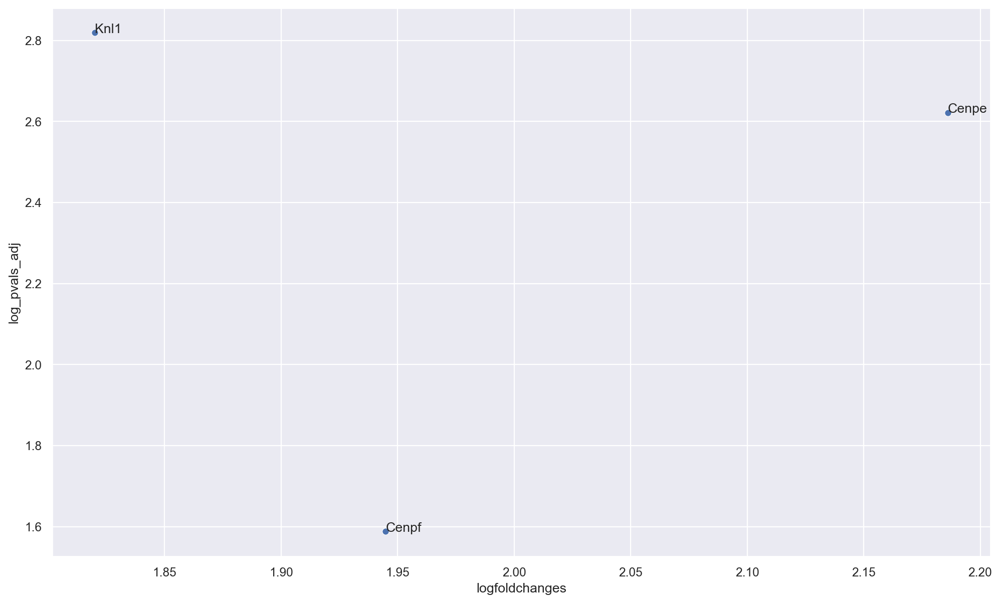

In [84]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

sns.set(rc={"figure.figsize":(15, 9)})

sns.scatterplot(data=volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered, x='logfoldchanges', y= 'log_pvals_adj')
for line in range(0,volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.shape[0]):
     plt.text(volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.logfoldchanges[line], volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.log_pvals_adj[line], volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.names[line])
plt.show()

In [85]:
import gseapy
gene_set_names = gseapy.get_library_name(organism='Mouse')

In [86]:
glist_Old_transplanted = sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group='IL10_Old_transplanted', key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN', pval_cutoff=0.05, log2fc_min=0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_transplanted_Ambient_RNA_cleaned_process = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_upregulated_DGEs_GO_BP_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [87]:
significant_terms.shape

(43, 10)

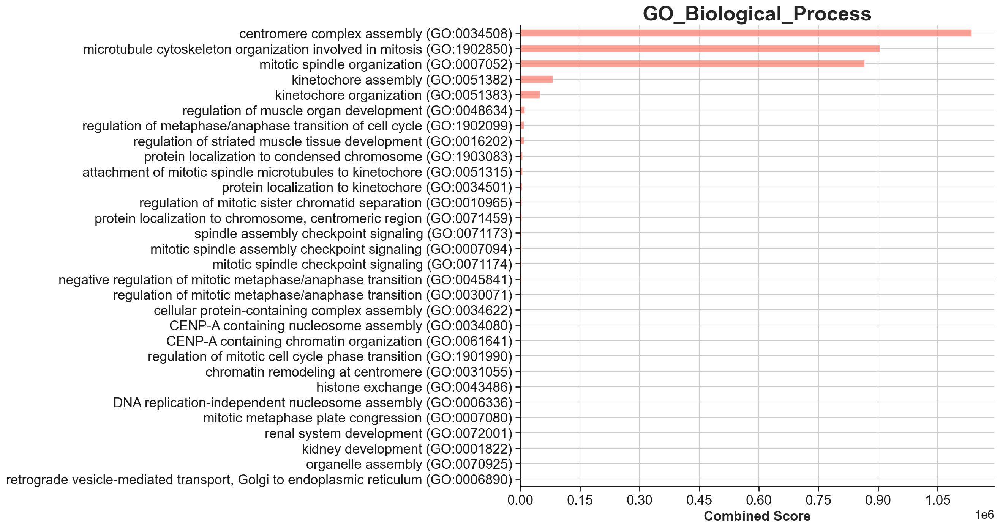

In [88]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [89]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_function = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_upregulated_DGEs_GO_MF_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [90]:
significant_terms.shape

(2, 10)

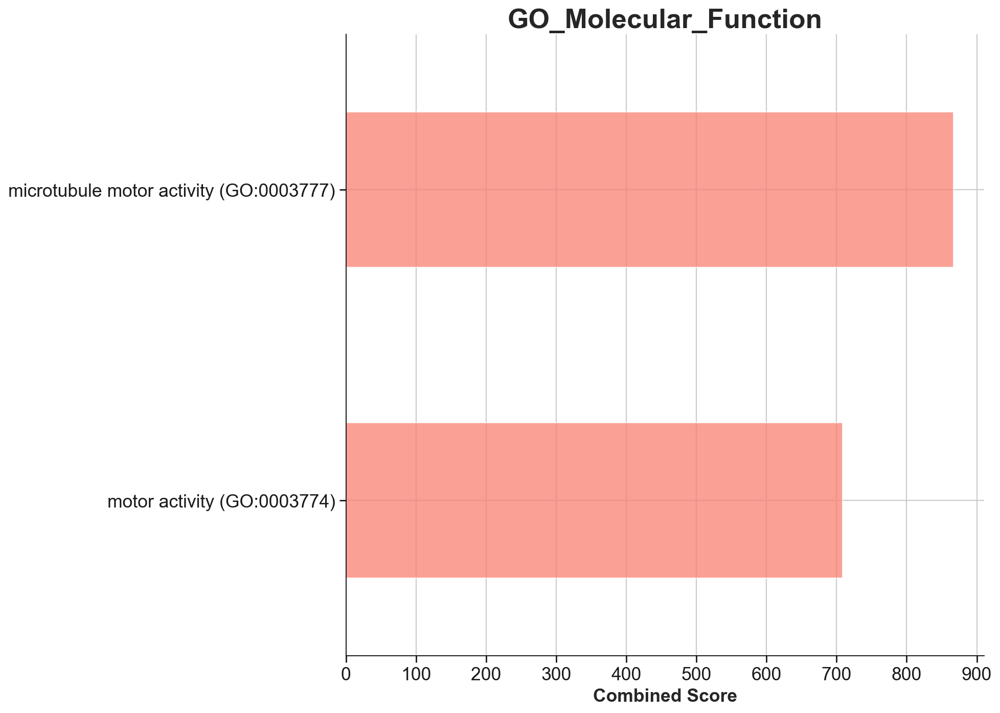

In [91]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [92]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_upregulated_DGEs_GO_CC_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [93]:
significant_terms.shape

(13, 10)

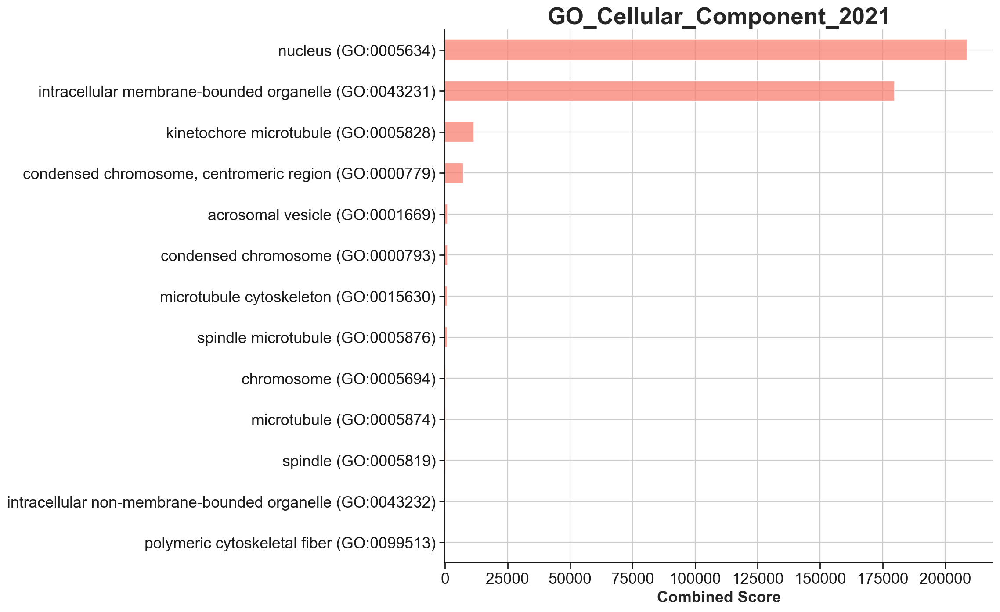

In [94]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [95]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_upregulated_DGEs_KEGG_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)
2022-05-05 12:58:22,591 Warning: No enrich terms using library KEGG_2019_Mouse when cutoff = 0.05


In [96]:
significant_terms.shape

(0, 10)

In [97]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

TypeError: no numeric data to plot

In [98]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_upregulated_DGEs_WIKI_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)
2022-05-05 12:59:14,383 Warning: No enrich terms using library WikiPathways_2019_Mouse when cutoff = 0.05


In [99]:
significant_terms.shape

(0, 10)

In [100]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

TypeError: no numeric data to plot

In [101]:
glist_Old_transplanted = sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group='IL10_Old_transplanted', key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN', pval_cutoff=0.05, log2fc_max=-0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_transplanted_Ambient_RNA_cleaned_process = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_downregulated_DGEs_GO_BP_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

Exception: Error analyzing gene list

In [ ]:
significant_terms.shape

In [ ]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_function = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_downregulated_DGEs_GO_MF_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_downregulated_DGEs_GO_CC_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_downregulated_DGEs_KEGG_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_DN_significantly_downregulated_DGEs_WIKI_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

In [102]:
sc.tl.rank_genes_groups(Old_transplanted_Ambient_RNA_cleaned_HSC, 'IL10', groups = ['IL10_Old_transplanted'], reference = 'IL10ra_Old_transplanted', method='wilcoxon', corr_method='bonferroni', key_added = 'wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra', use_raw=False)
result = Old_transplanted_Ambient_RNA_cleaned_HSC.uns['wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals', 'pvals_adj']}).head(10)

,IL10_Old_transplanted_n,IL10_Old_transplanted_p
0,Igkc,1.0
1,Igha,1.0
2,D10Wsu102e,1.0
3,Spcs1,1.0
4,Jchain,1.0
5,Ckap4,1.0
6,Serp1,1.0
7,Ptms,1.0
8,Khdc4,1.0
9,H13,1.0


In [103]:
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC = sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group=None, key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra')
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_DGE_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_regress_combat_raw_SingleR_beforehand.csv")

In [104]:
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered = volcano_Old_transplanted_Ambient_RNA_cleaned_HSC[volcano_Old_transplanted_Ambient_RNA_cleaned_HSC['pvals_adj'] < 0.05]
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['pvals_adj'])
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.reset_index(inplace=True, drop=True)
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_005_DGE_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_regress_combat_raw_SingleR_beforehand.csv")
volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered

/tmp/ipykernel_1224000/3932123152.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered['pvals_adj'])


,names,scores,logfoldchanges,pvals,pvals_adj,log_pvals_adj
0,Knl1,-4.354281,1.369241,0.000013,0.044884,1.347907
1,Prtn3,-4.359632,NaN,0.000013,0.043801,1.358521


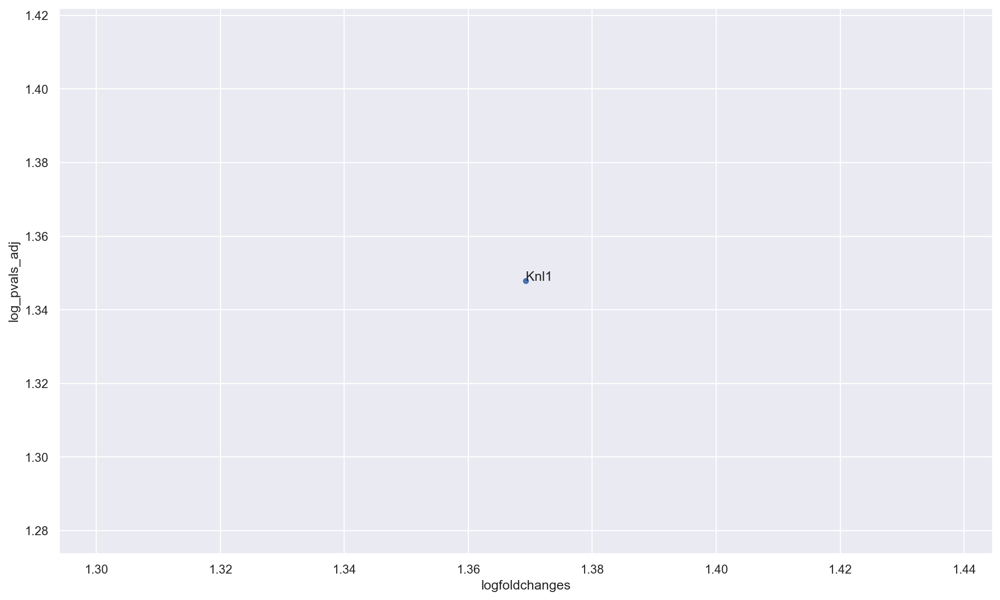

In [105]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

sns.set(rc={"figure.figsize":(15, 9)})

sns.scatterplot(data=volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered, x='logfoldchanges', y= 'log_pvals_adj')
for line in range(0,volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.shape[0]):
     plt.text(volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.logfoldchanges[line], volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.log_pvals_adj[line], volcano_Old_transplanted_Ambient_RNA_cleaned_HSC_filtered.names[line])
plt.show()

In [106]:
import gseapy
gene_set_names = gseapy.get_library_name(organism='Mouse')

In [107]:
glist_Old_transplanted = sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group='IL10_Old_transplanted', key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra', pval_cutoff=0.05, log2fc_min=0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_transplanted_Ambient_RNA_cleaned_process = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_upregulated_DGEs_GO_BP_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

AttributeError: 'str' object has no attribute 'str'

In [ ]:
significant_terms.shape

In [ ]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_function = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_upregulated_DGEs_GO_MF_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_upregulated_DGEs_GO_CC_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_upregulated_DGEs_KEGG_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_upregulated_DGEs_WIKI_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Upregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

In [ ]:
glist_Old_transplanted = sc.get.rank_genes_groups_df(Old_transplanted_Ambient_RNA_cleaned_HSC, group='IL10_Old_transplanted', key='wilcoxon_bonferroni_Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra', pval_cutoff=0.05, log2fc_max=-0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_transplanted_Ambient_RNA_cleaned_process = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_downregulated_DGEs_GO_BP_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_function = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_downregulated_DGEs_GO_MF_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_downregulated_DGEs_GO_CC_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_downregulated_DGEs_KEGG_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [ ]:
enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI = gseapy.enrichr(gene_list=glist_Old_transplanted, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d[enr_res_Old_transplanted_Ambient_RNA_cleaned_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Old_transplanted/write/Ambient_RNA_Cleaned/Old_transplanted_Ambient_RNA_cleaned_IL10_vs_IL10ra_significantly_downregulated_DGEs_WIKI_005_terms_join_inner_200_3_10_5_scrublet_no_mt_2_UMI_5_percent_combat_regress_beforehand.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old transplanted IL10 vs DN Downregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))